In [1]:
# ! pip install segmentation-models-pytorch albumentations scikit-learn

In [2]:
# !pip3.11 install torch==2.5.1 torchvision==0.20.1 torchaudio==2.5.1

In [1]:
import glob
import os
import random
import pandas as pd
import albumentations as A
import cv2
import torch
import matplotlib.pyplot as plt
import numpy as np
import segmentation_models_pytorch as smp
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset

from losses import ComboLoss, FocalLoss2d

## 4 класса на изображении - плита, духовка, микроволновка и чайник.

In [2]:
SEED = 60

def set_seed():
    random.seed(SEED)
    np.random.seed(SEED)
    torch.manual_seed(SEED)
#     torch.cuda.manual_seed(SEED)
#     torch.cuda.manual_seed_all(SEED)
#     torch.backends.cudnn.deterministic = True

    os.environ['PYTHONHASHSEED'] = str(SEED)
#     os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
#     os.environ['CUDA_VISIBLE_DEVICES']= '1'

device = 'mps'

BATCH_SIZE = 4
DECODERS = smp._MODEL_ARCHITECTURES

In [3]:
DECODERS

[segmentation_models_pytorch.decoders.unet.model.Unet,
 segmentation_models_pytorch.decoders.unetplusplus.model.UnetPlusPlus,
 segmentation_models_pytorch.decoders.manet.model.MAnet,
 segmentation_models_pytorch.decoders.linknet.model.Linknet,
 segmentation_models_pytorch.decoders.fpn.model.FPN,
 segmentation_models_pytorch.decoders.pspnet.model.PSPNet,
 segmentation_models_pytorch.decoders.deeplabv3.model.DeepLabV3,
 segmentation_models_pytorch.decoders.deeplabv3.model.DeepLabV3Plus,
 segmentation_models_pytorch.decoders.pan.model.PAN,
 segmentation_models_pytorch.decoders.upernet.model.UPerNet,
 segmentation_models_pytorch.decoders.segformer.model.Segformer]

In [4]:
def plot_images_side_by_side(image1, image2, title1='', title2=''):
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    
    axs[0].imshow(image1)
    axs[0].set_title(title1)
    axs[0].axis('off')
    
    axs[1].imshow(image2)
    axs[1].set_title(title2)
    axs[1].axis('off')
    
    plt.show()


def dice_channels(prob, truth, threshold=0.5, eps = 1E-9):
    num_imgs = prob.size(0)
    num_channels = prob.size(1)
    prob = (prob > threshold).float()
    truth = (truth > 0.5).float()
    prob = prob.view(num_imgs, num_channels, -1)
    truth = truth.view(num_imgs, num_channels, -1)
    intersection = (prob * truth)
    score = (2. * intersection.sum(2) + eps) / (prob.sum(2) + truth.sum(2) + eps)
    score[score >= 1] = 1
    return score.mean()


def train_epoch(loader, model, loss_function_seg, optimizer, device):
    model = model.to(device)
    model.train()
    avg_loss = 0.
    optimizer.zero_grad()
    for image, mask in loader:
        x = image.to(device)
        y = mask.to(device)
        prediction_seg = model(x)
        loss = loss_function_seg(prediction_seg, y)
        loss.backward()
        optimizer.step()
#         scheduler.step()
        optimizer.zero_grad() 
        avg_loss += loss.item()
    avg_loss /= len(loader)
    return avg_loss


def valid_epoch(loader, model, device):
    model = model.to(device)
    model.eval()
    scores = []
    with torch.no_grad():
        for image, mask in loader:
            x = image.to(device)
            y = mask.to(device)
            probs = torch.sigmoid(model(x))
            scores.append(dice_channels(probs, y))
    return torch.stack(scores).mean().item()


def mask2rle(mask):
    '''
    mask: numpy array, 1 - pixel classified as target, 0 - background
    Returns run length as string formated
    '''
    rles = []
    for channel in range(mask.shape[2]):
        channel_mask = mask[:, :, channel]
        pixels = channel_mask.T.flatten()
        pixels = np.concatenate([[0], pixels, [0]])
        runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
        runs[1::2] -= runs[::2]
        rle_channel = ' '.join(str(x) for x in runs)
        rles.append(rle_channel)
    return ';'.join(rles)
 

def get_submission_df(img_paths, transforms, model, device='mps'):
    '''
    img_paths: list of paths to test images
    transforms: albumentation test transforms
    model: the trained model
    Returns submission dataframe
    '''
    model = model.to(device)
    model.eval()
    submission_df = pd.DataFrame()
    c = 0
    with torch.no_grad():
        for n, img_path in enumerate(img_paths):
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            transformed_data = transforms(image=img)
            transformed_img = transformed_data['image']
            model_input = torch.from_numpy(transformed_img).permute(2, 0, 1).unsqueeze(0)
            pred = model(model_input.to(device))
            mask = torch.sigmoid(pred).squeeze().cpu() > 0.5
            resized_mask = cv2.resize(
                mask.numpy().transpose((1, 2, 0)).astype(int),
                (img.shape[1], img.shape[0]),
                interpolation=cv2.INTER_NEAREST
            )
            submission_df.loc[c, 'image_id'] = os.path.basename(img_path)
            submission_df.loc[c, 'rle'] = mask2rle(resized_mask)
            submission_df.loc[c, 'batch_number'] = c
            c += 1
    return submission_df

In [124]:
train_transforms = A.Compose([
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.05, hue=0.05, p=1.0),
    A.HorizontalFlip(p=0.5),
    A.Resize(500, 500),
    A.RandomCrop(384, 384, p=0.9),
    A.Normalize(),
])



# train_transforms = A.Compose([
#     A.GaussNoise(mean_range=(0.0, 0.0), 
#                  std_range=(0.01, 0.05)),
#     A.RandomToneCurve()
#     A.Rotate(limit=(-20, 20)),
#     A.HorizontalFlip(p=0.5),
#     A.Resize(384, 384),
#     A.Normalize(),
#     A.RandomCrop()
# ])

test_transforms = A.Compose([
    A.Resize(384, 384),
    A.Normalize()
])

In [125]:
class SegmentationDataset(Dataset):
    def __init__(self, img_paths, masks_paths, transforms):
        self.img_paths = img_paths
        self.masks_paths = masks_paths
        self.transforms = transforms
        
    def __getitem__(self, item):
        img_path = self.img_paths[item]
        mask_path = self.masks_paths[item]
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = np.load(mask_path)
        
        transformed_data = self.transforms(image=img, mask=mask)
        img = transformed_data['image']
        mask = transformed_data['mask']

        return torch.from_numpy(img).permute(2, 0, 1), torch.from_numpy(mask).permute(2, 0, 1).float()
    
    def __len__(self):
        return len(self.img_paths)

In [126]:
img_path = sorted(glob.glob('data/train/images/*.jpg'))[0]
mask_path = sorted(glob.glob('data/train/masks/*.npy'))[0]
img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
mask = np.load(mask_path)

transformed_data = train_transforms(image=img, mask=mask)
transformed_img = transformed_data['image']
transformed_mask = transformed_data['mask']

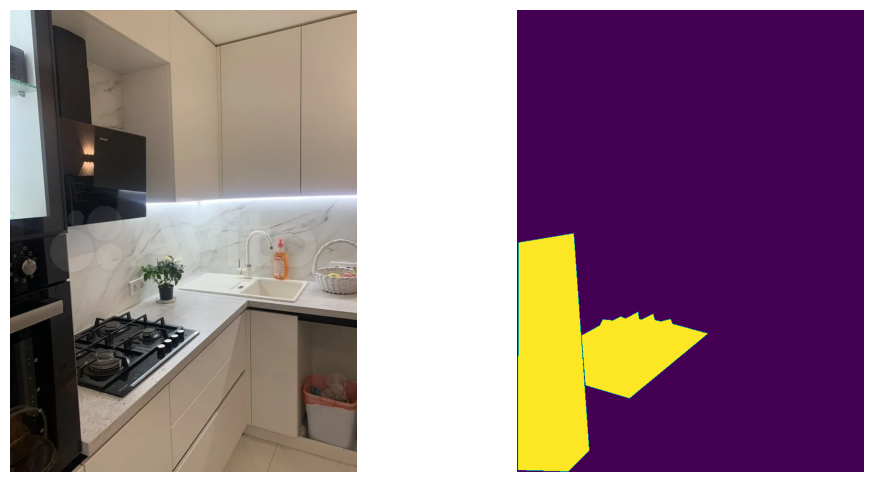

In [127]:
plot_images_side_by_side(img, np.sum(mask, axis=2))

In [128]:
img_path = sorted(glob.glob('data/train/images/*.jpg'))
mask_path = sorted(glob.glob('data/train/masks/*.npy'))
None

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


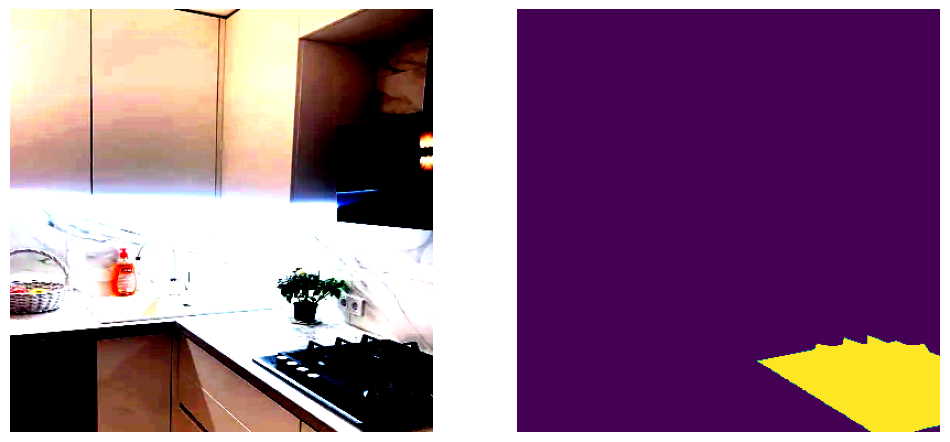

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


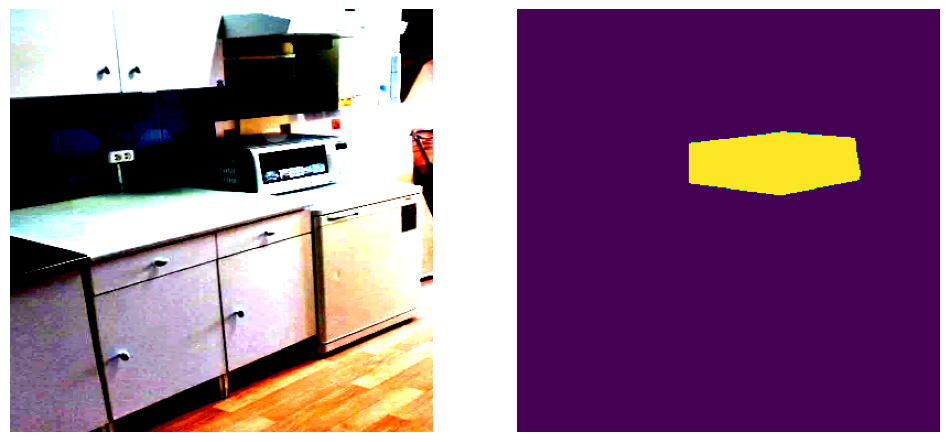

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


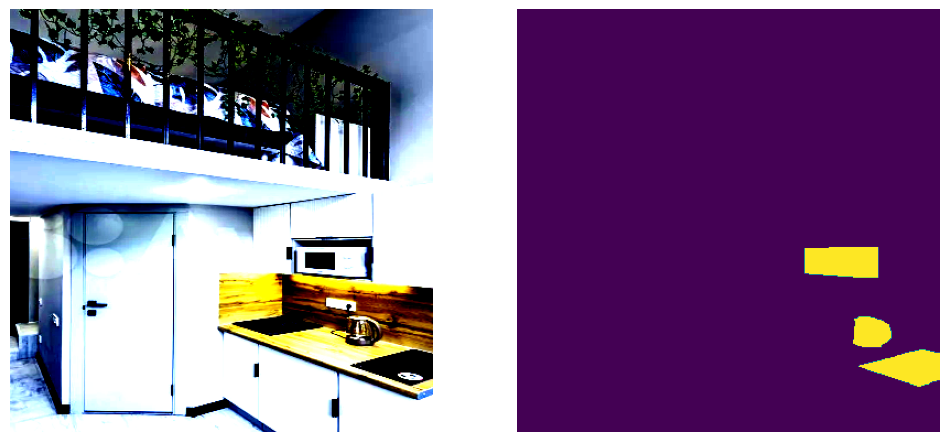

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


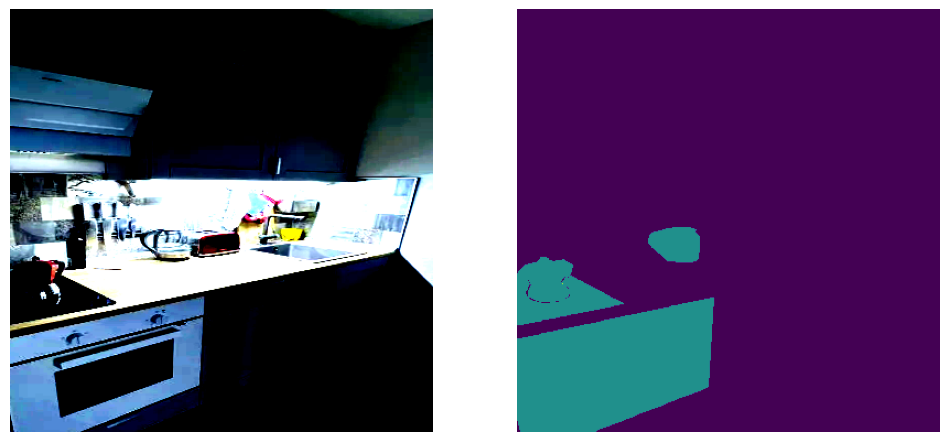

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


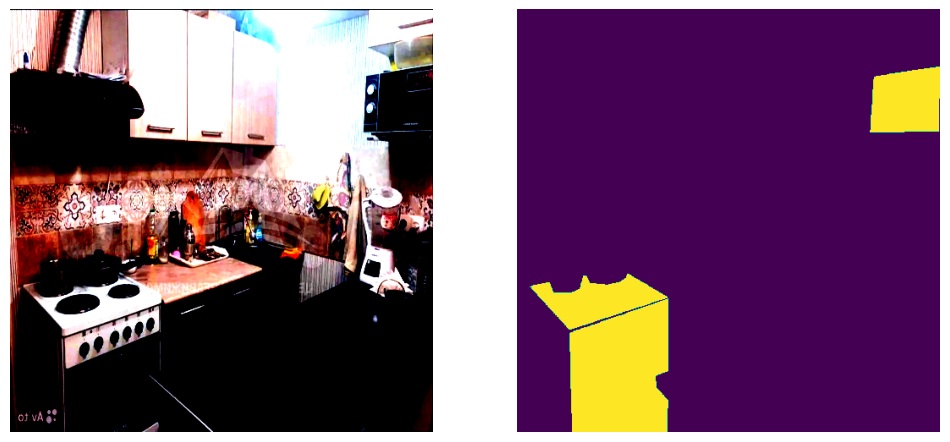

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


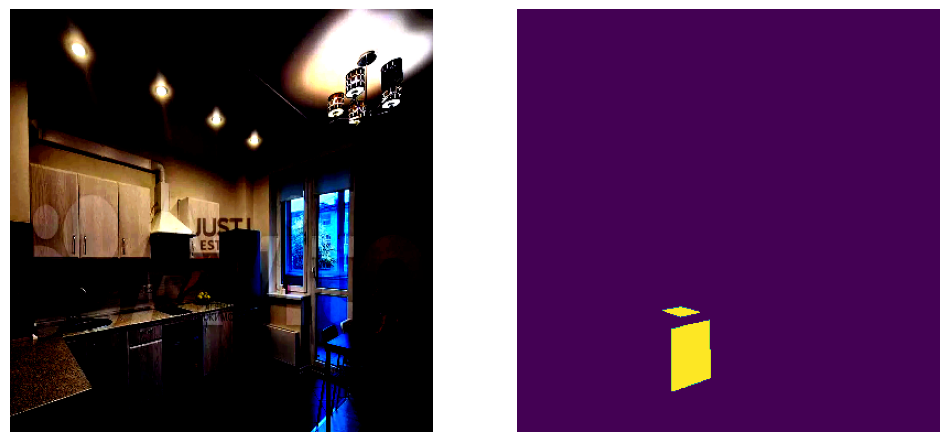

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


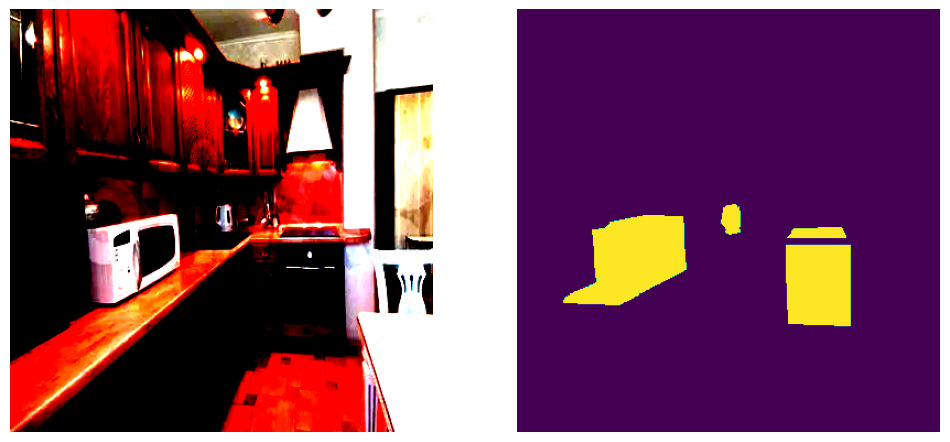

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


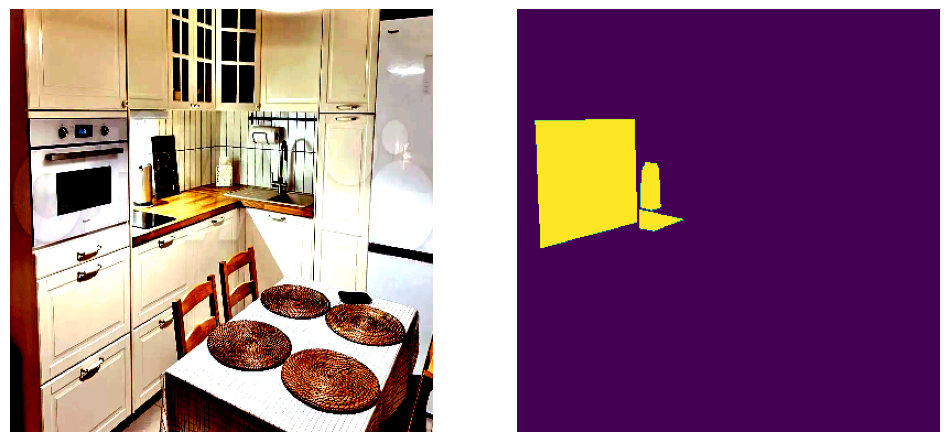

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


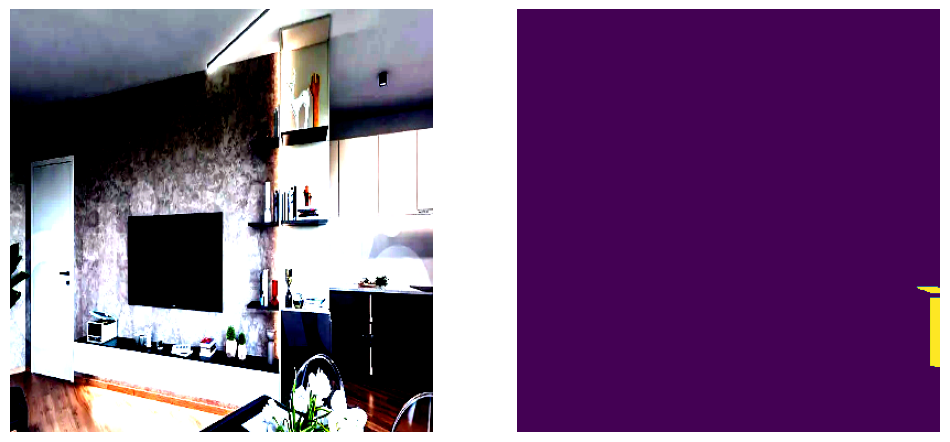

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


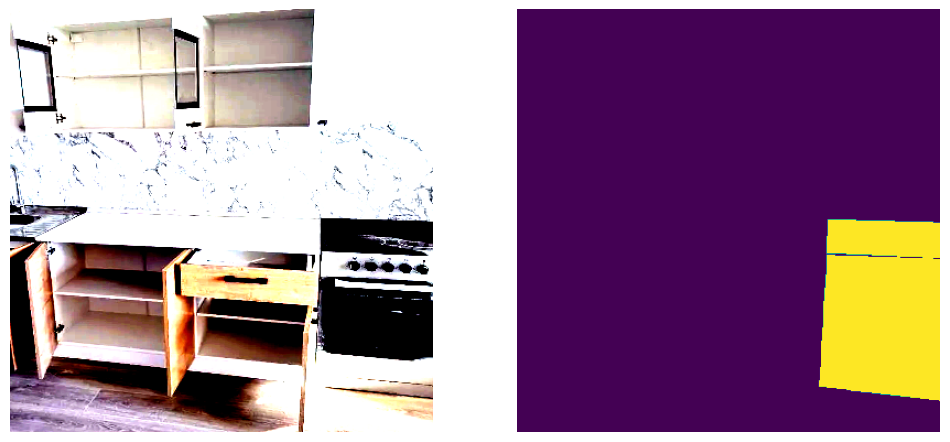

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


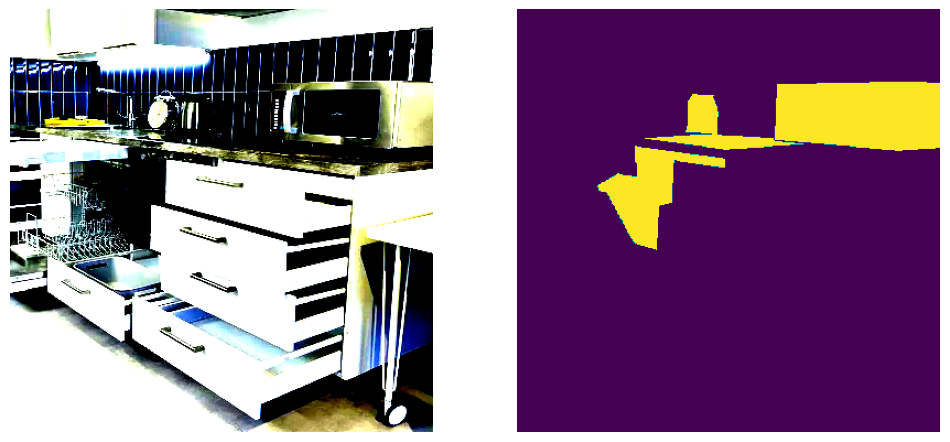

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


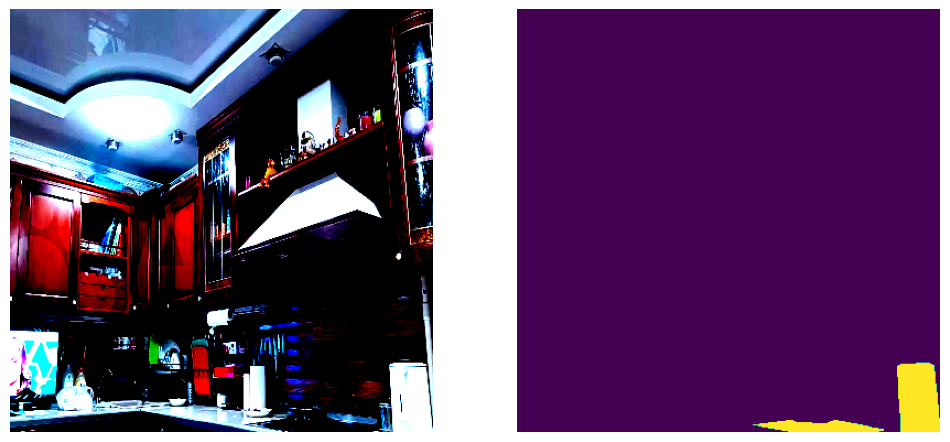

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


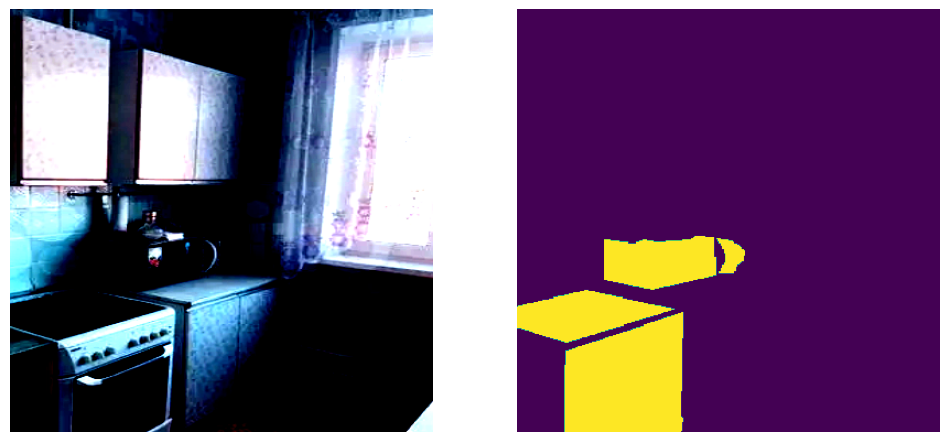

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


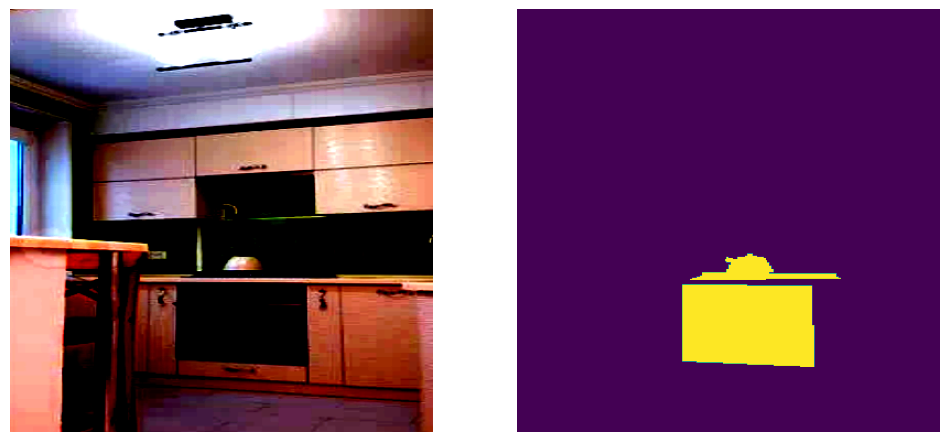

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


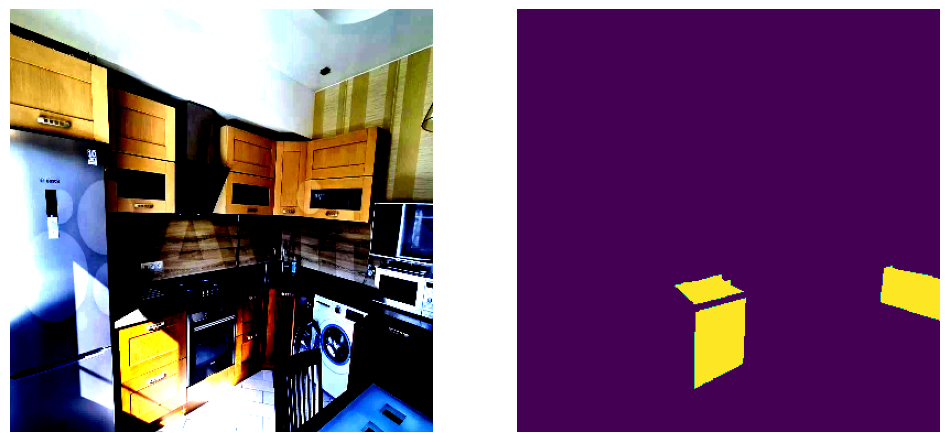

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


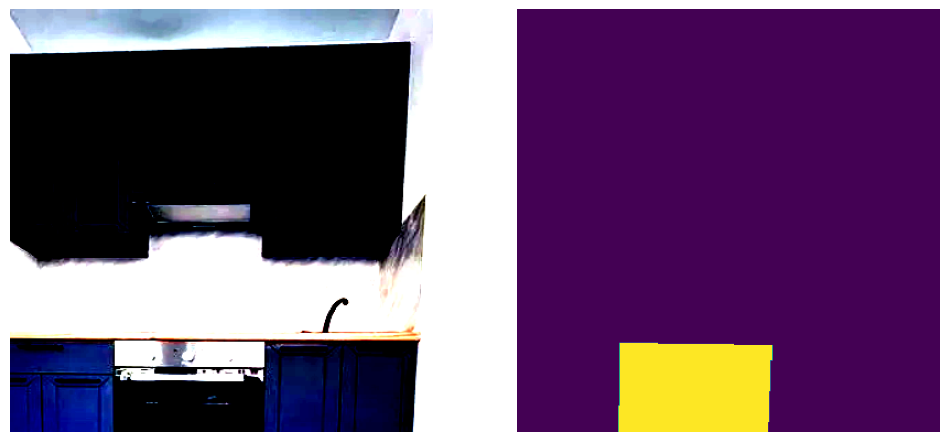

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


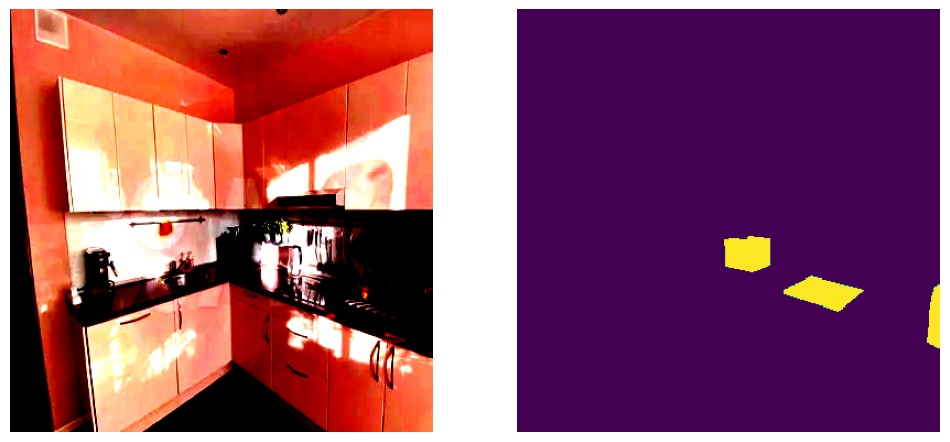

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


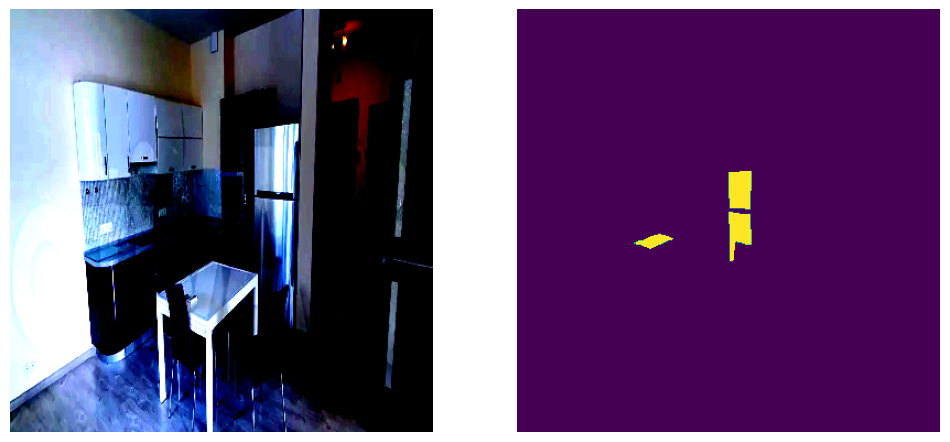

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


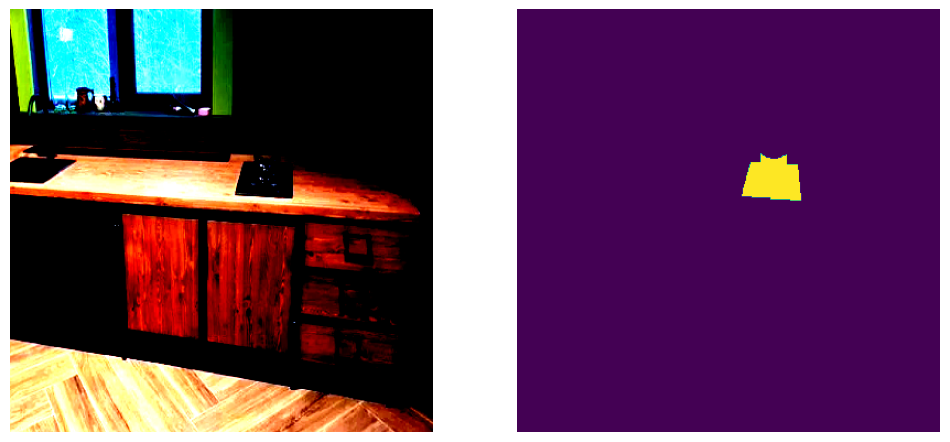

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


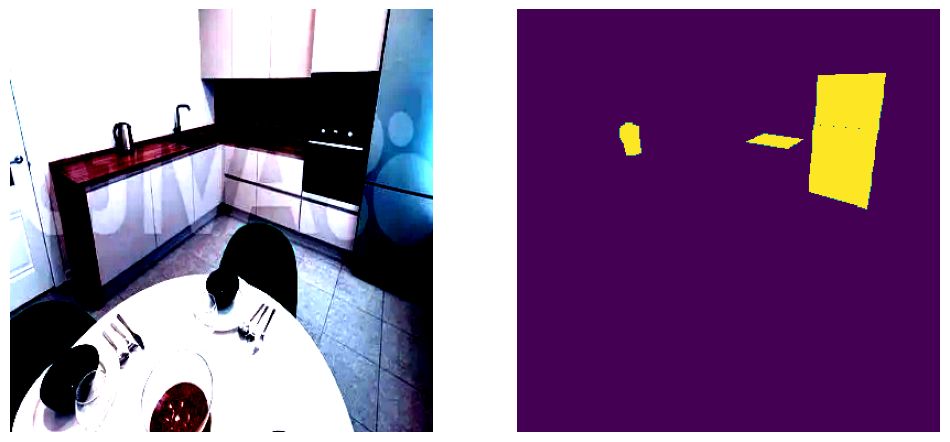

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


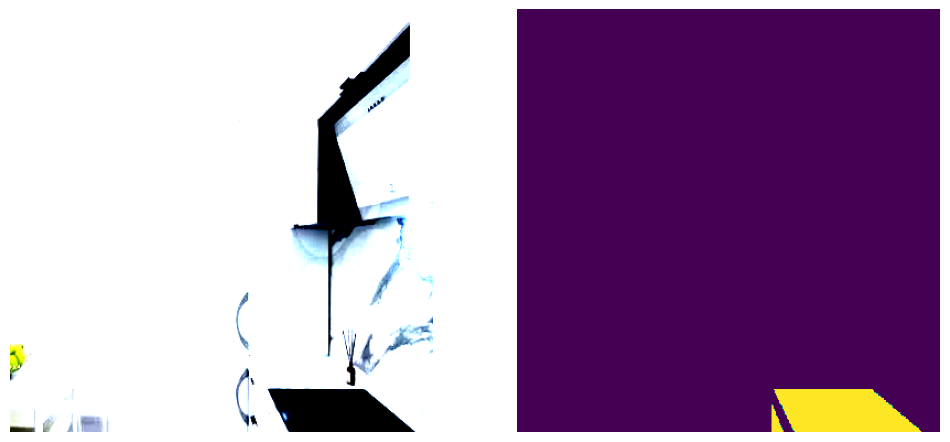

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


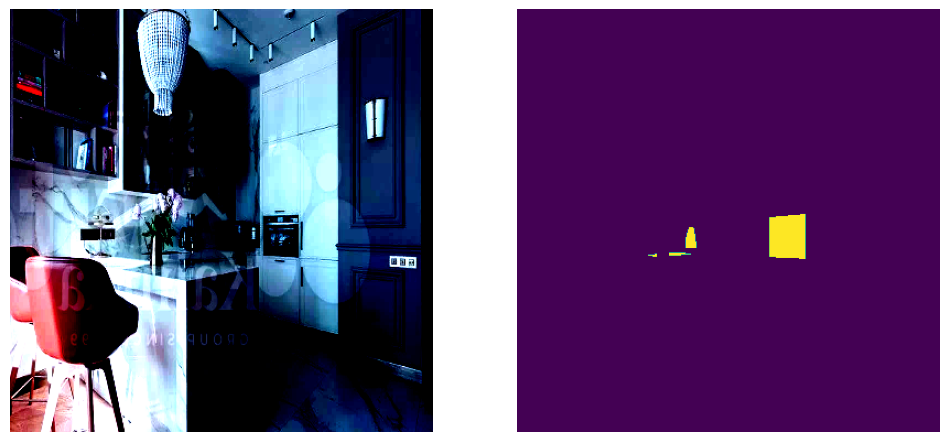

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


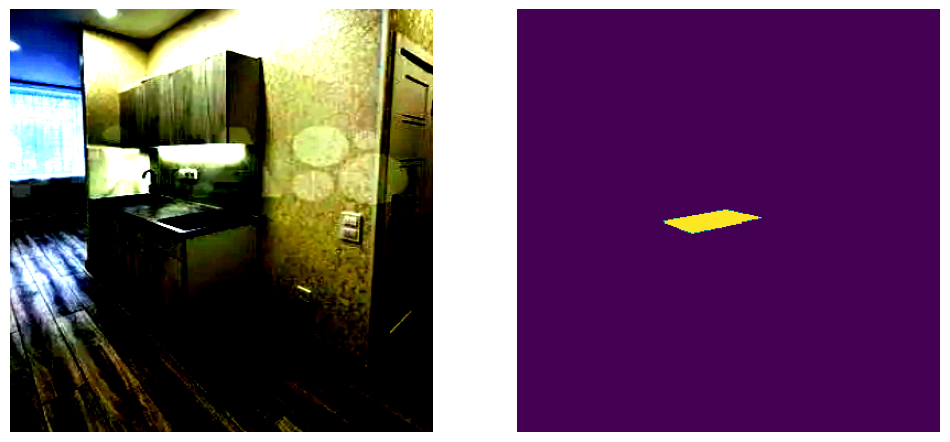

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


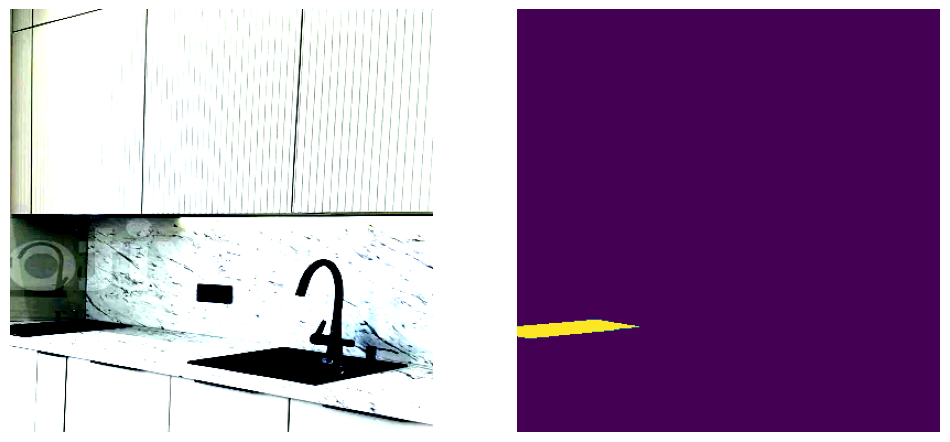

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


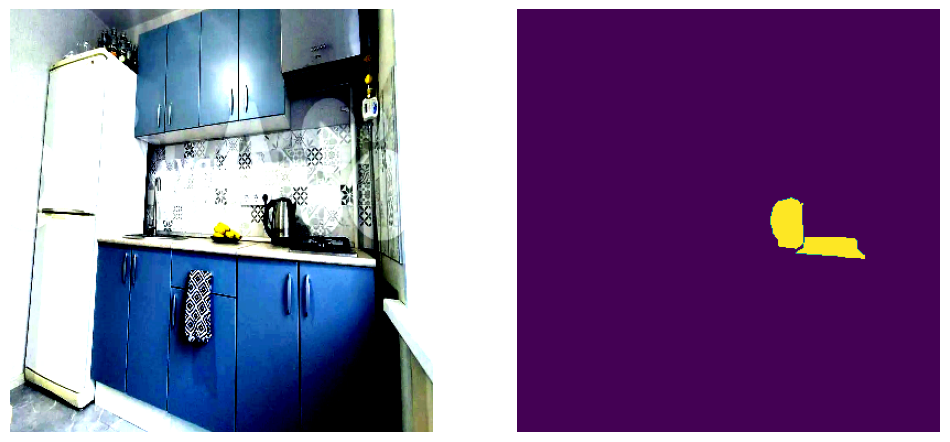

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


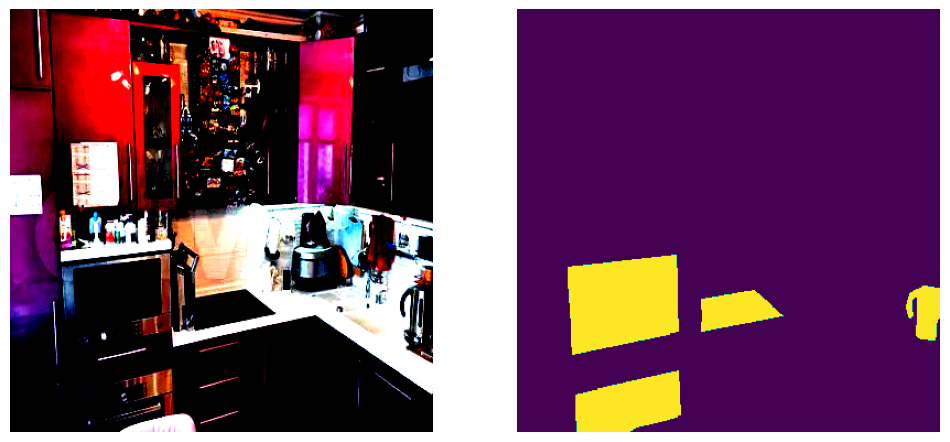

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


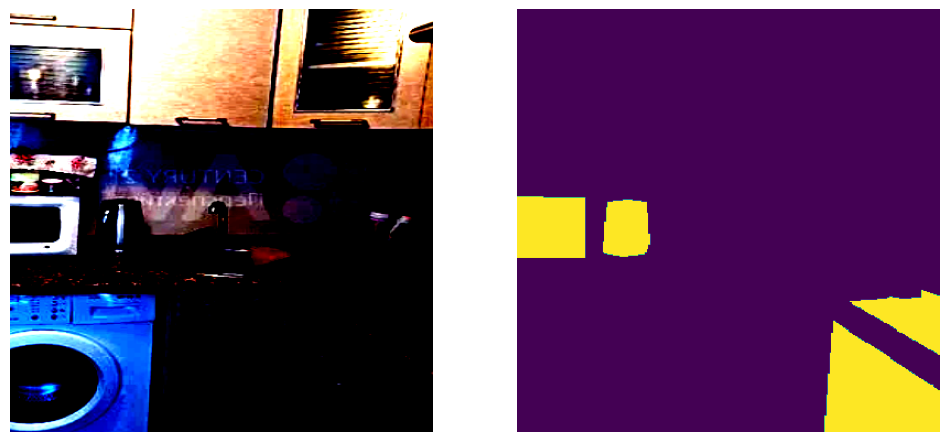

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


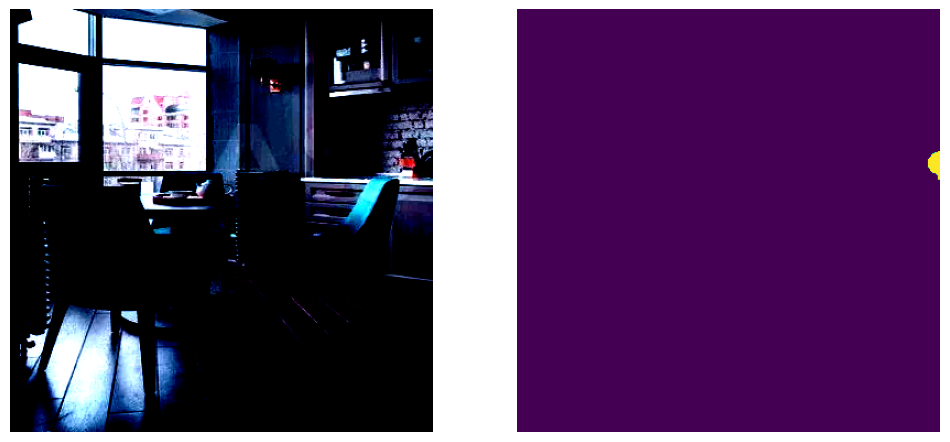

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


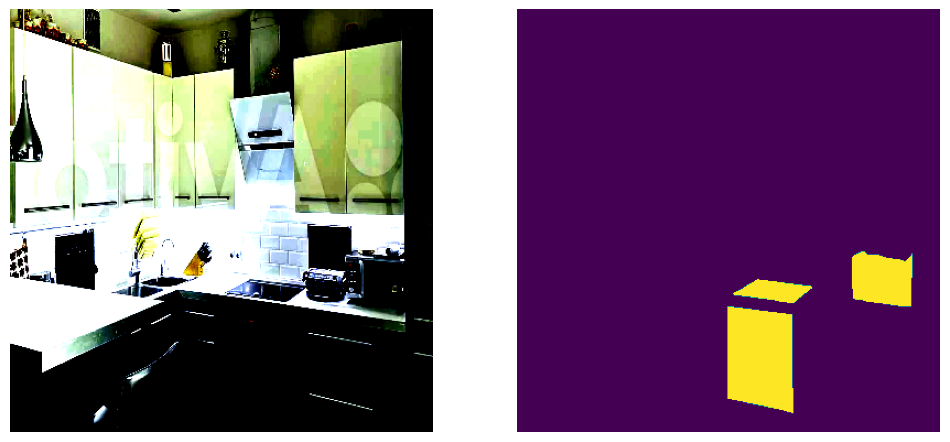

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


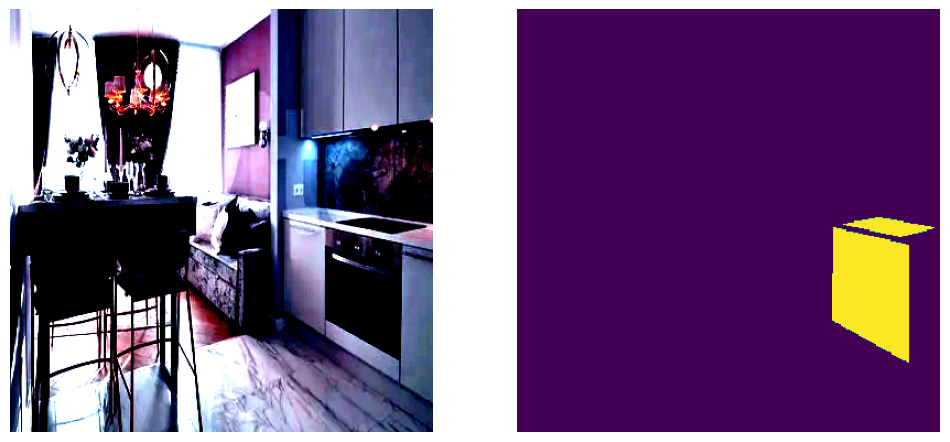

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


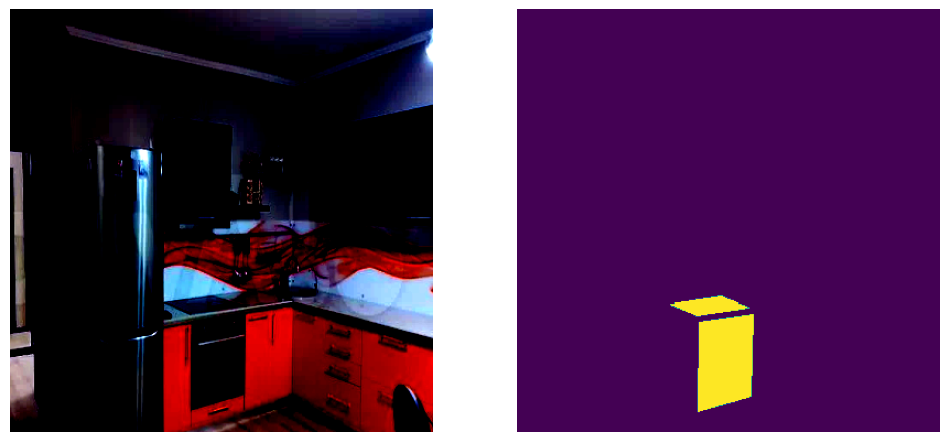

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


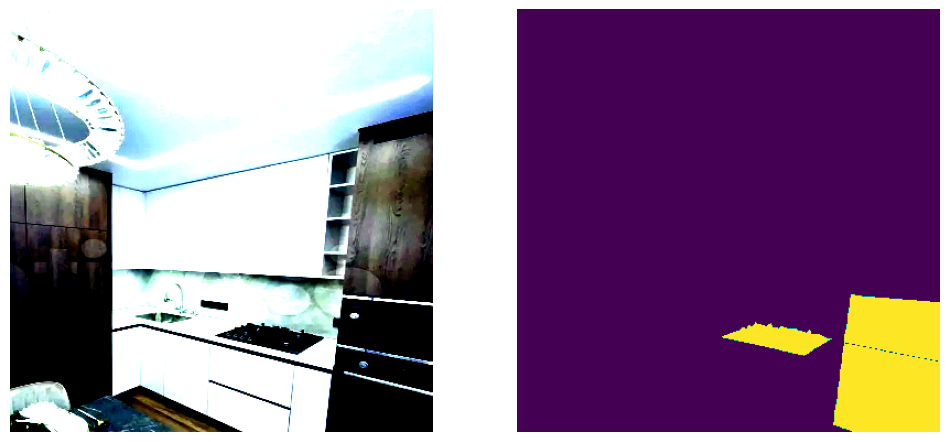

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


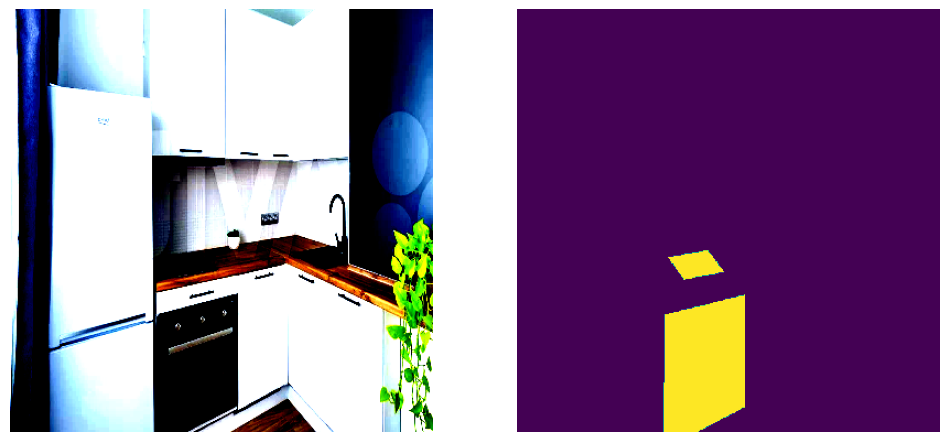

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


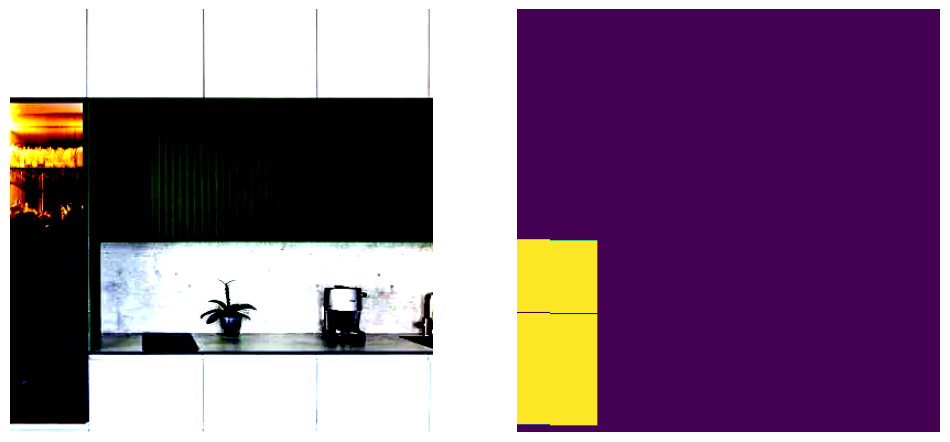

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


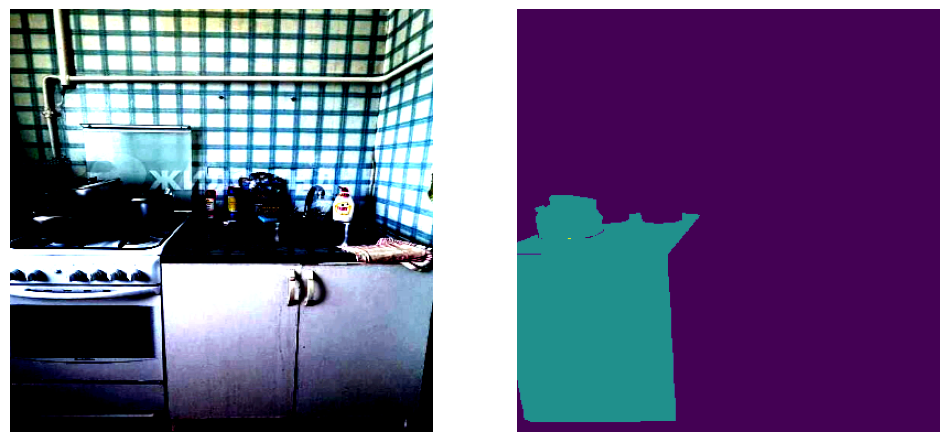

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


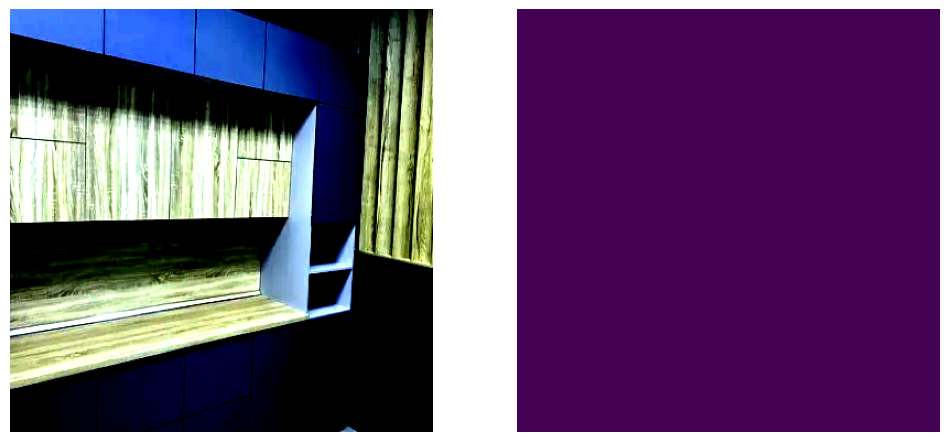

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


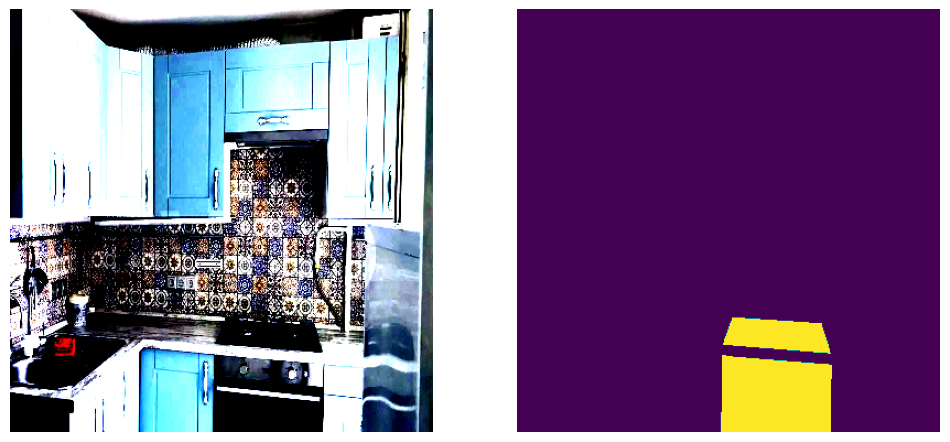

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


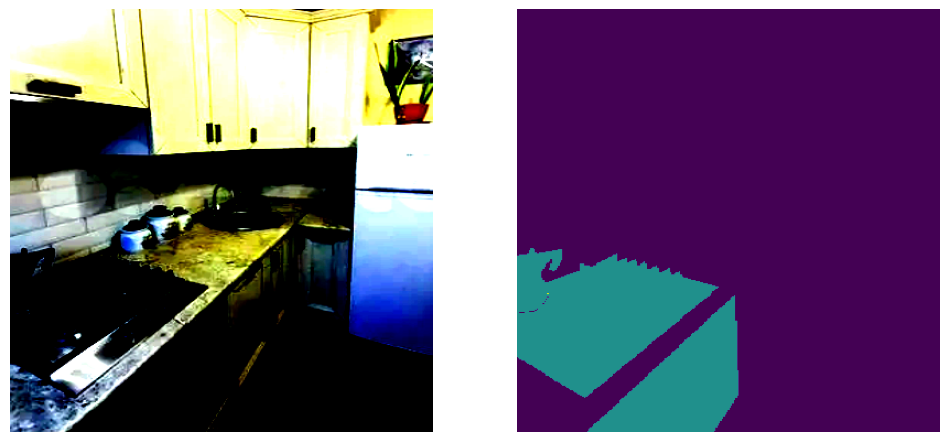

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


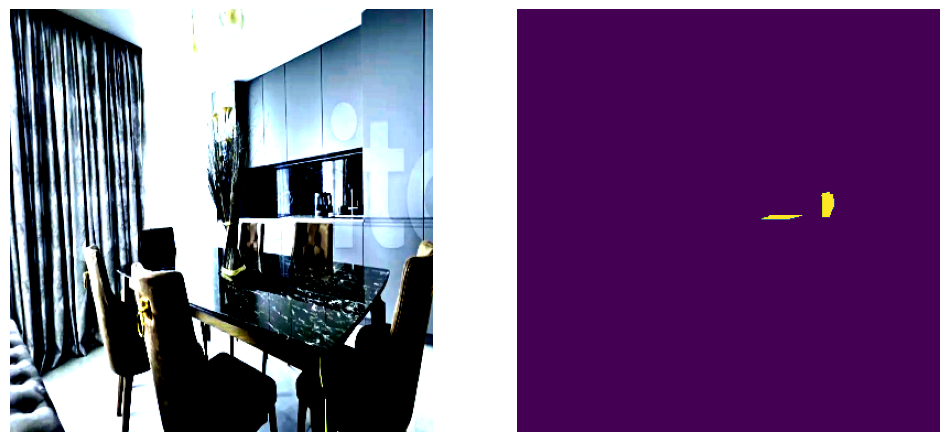

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


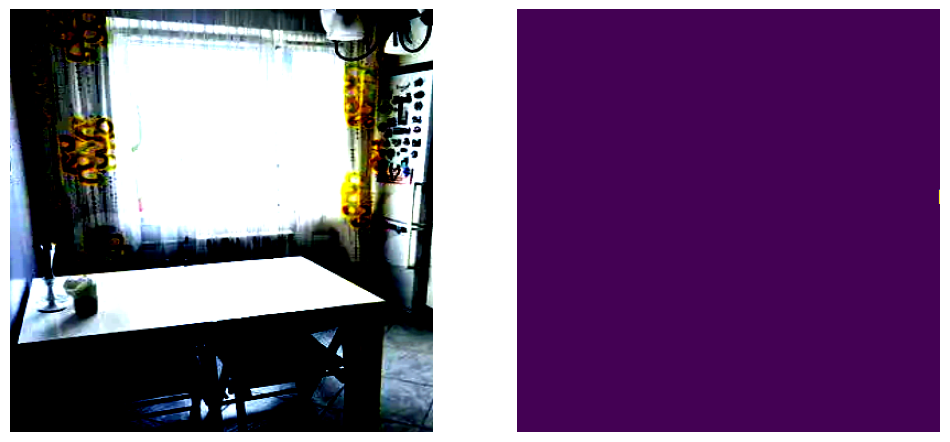

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


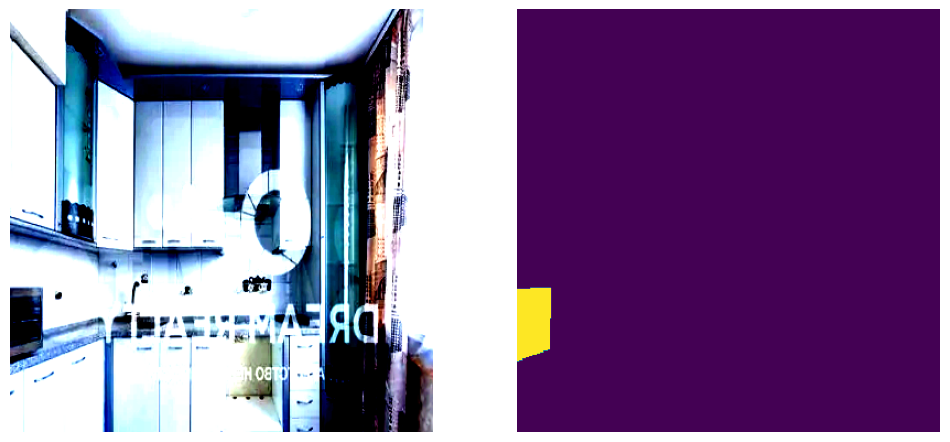

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


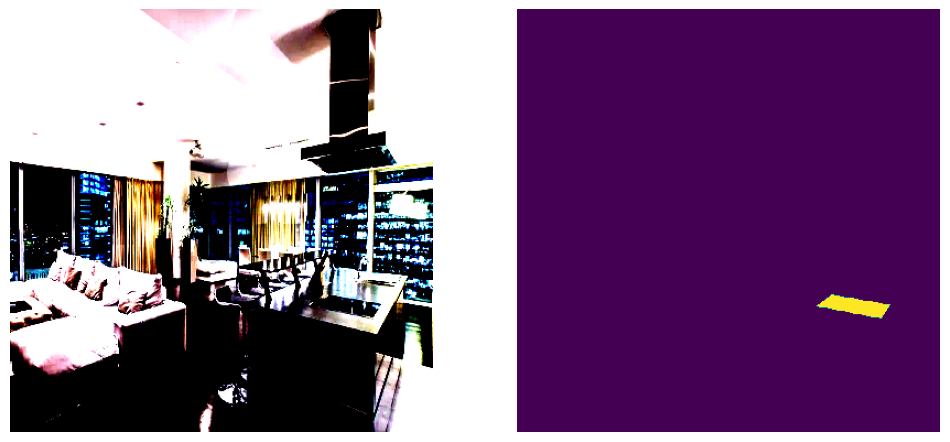

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


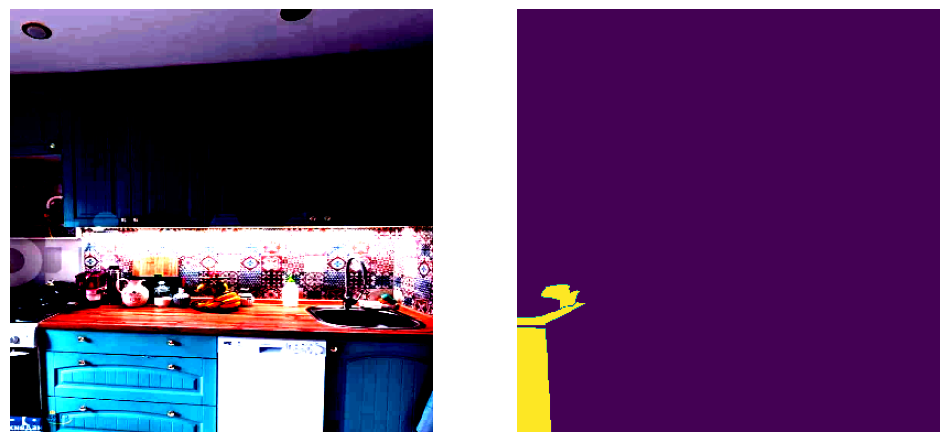

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


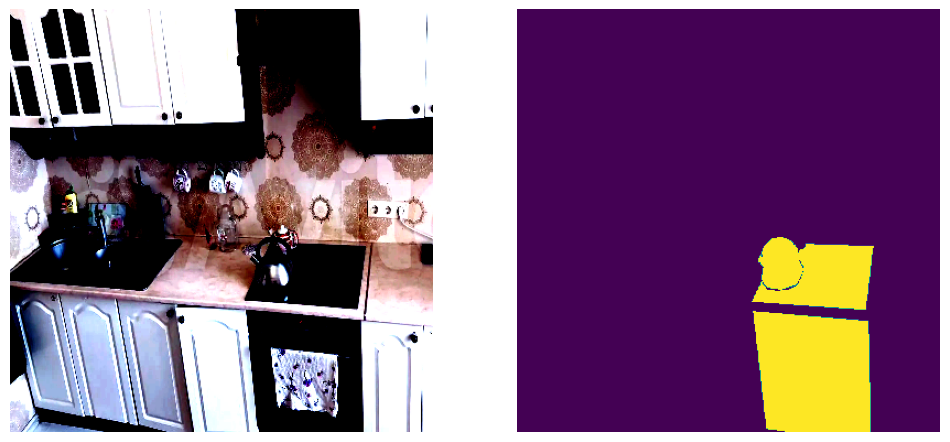

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


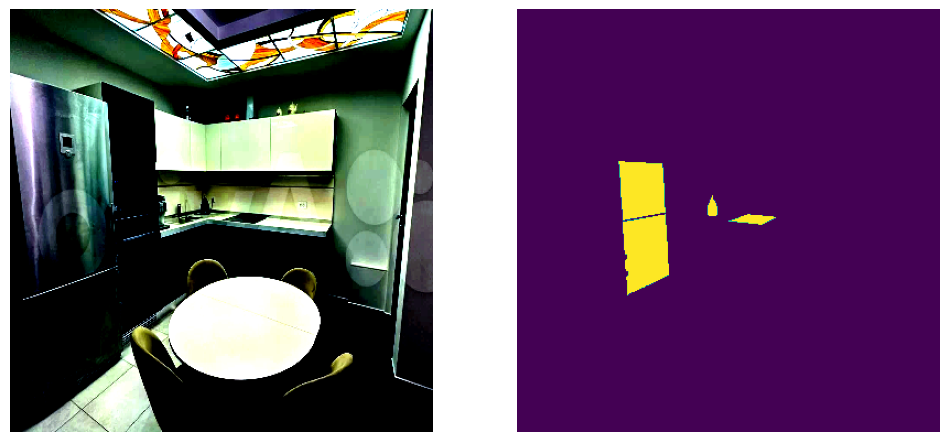

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


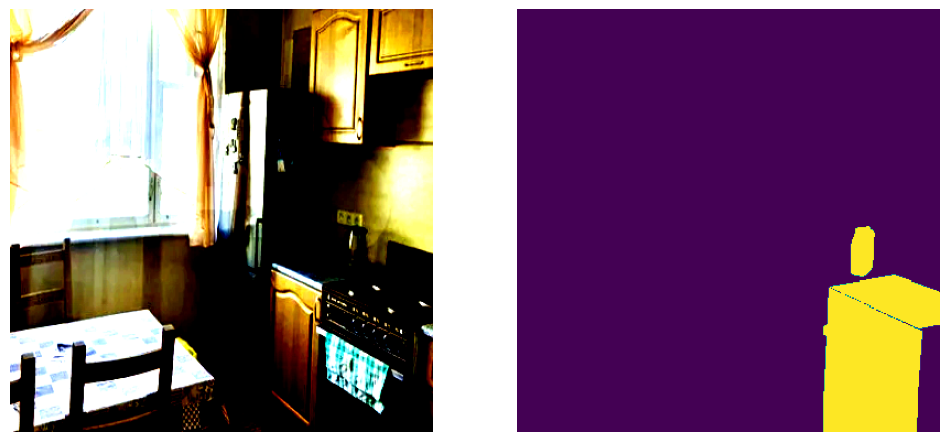

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


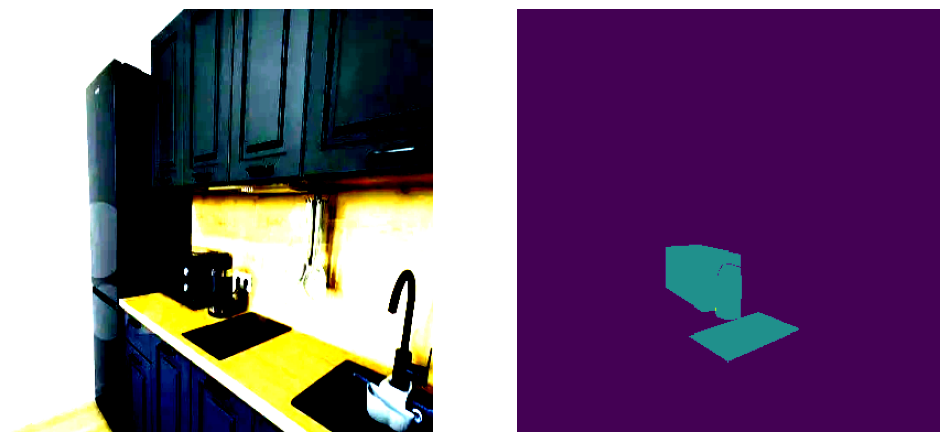

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


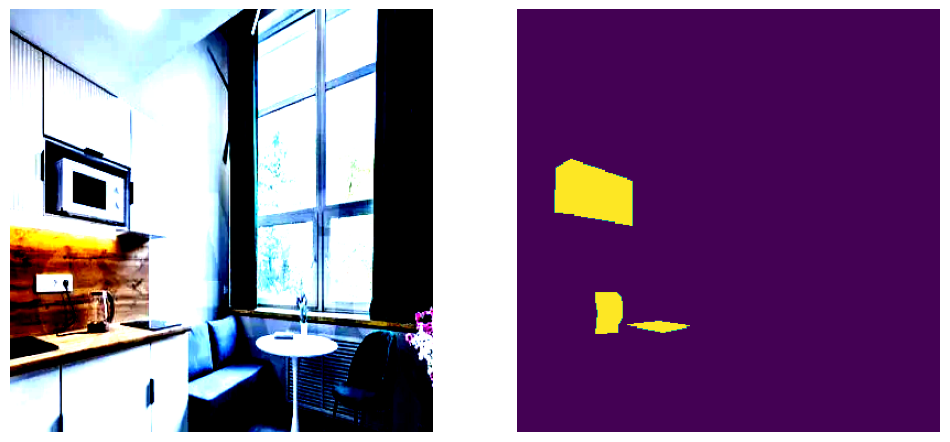

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


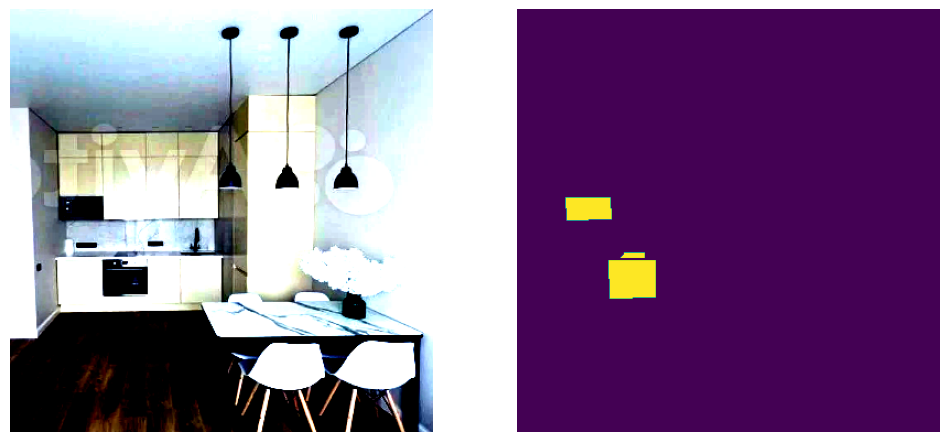

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


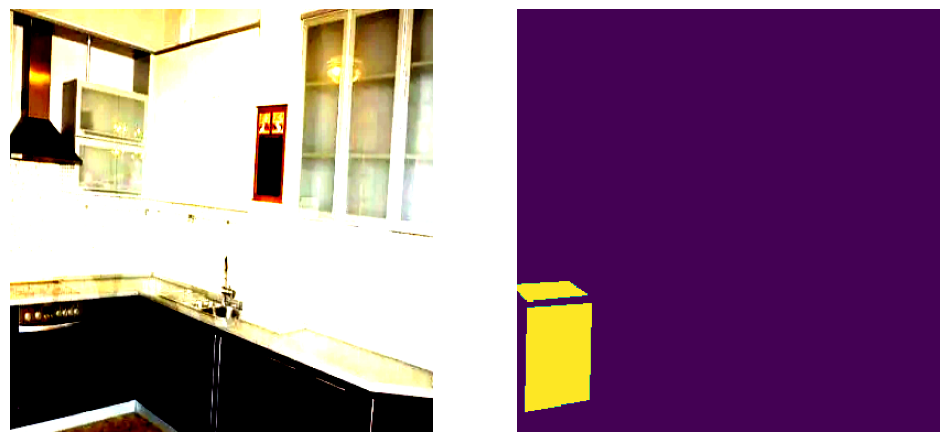

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


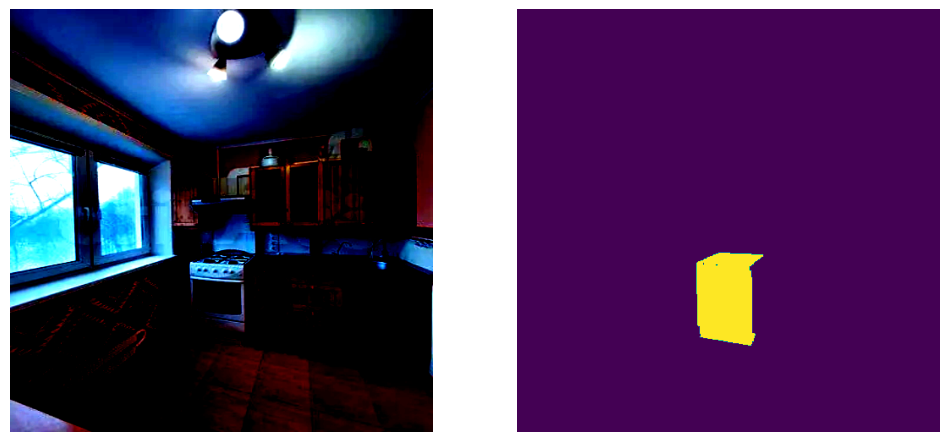

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


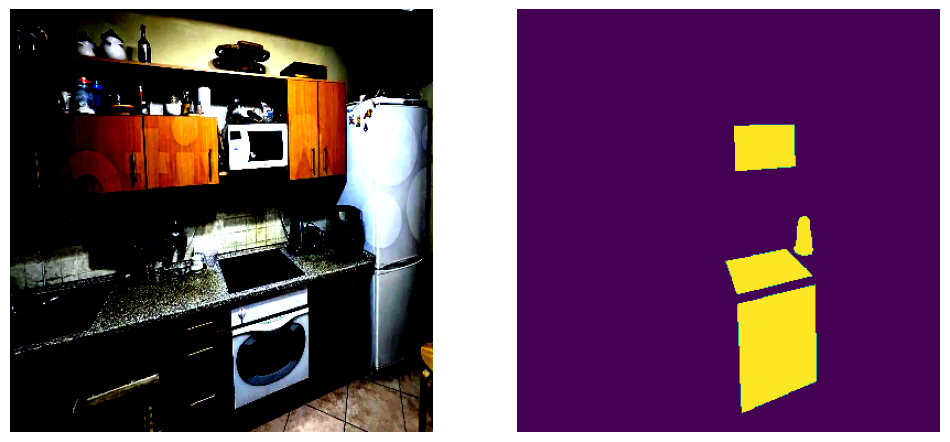

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


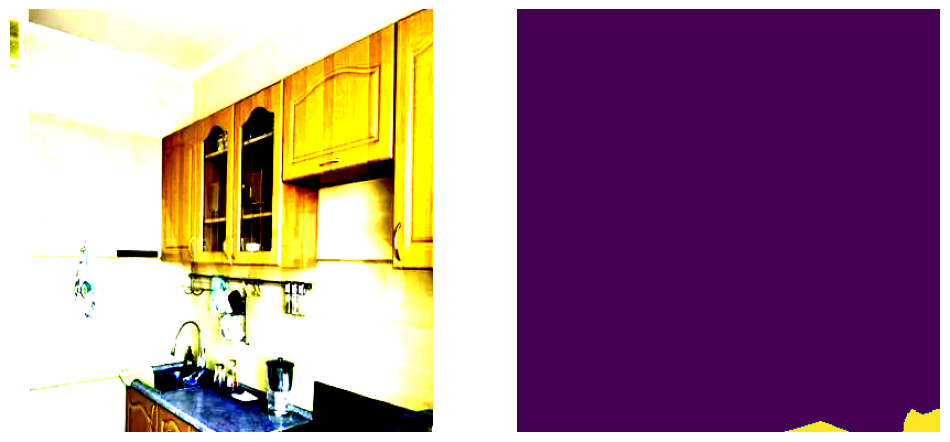

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


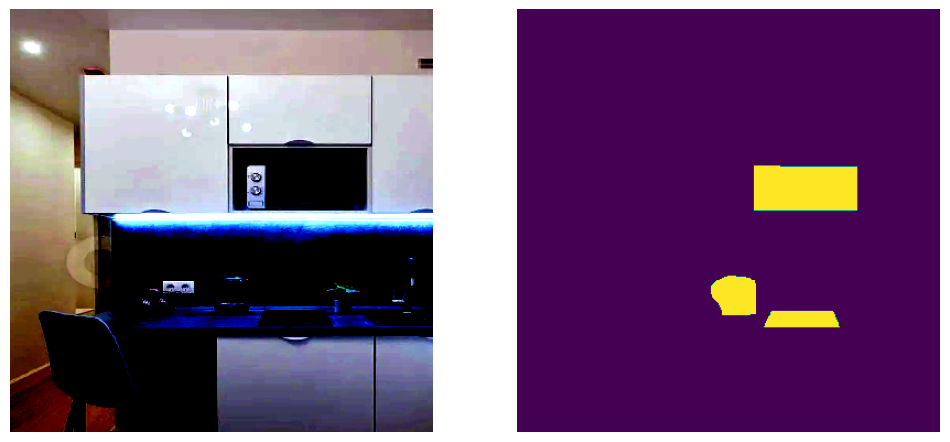

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


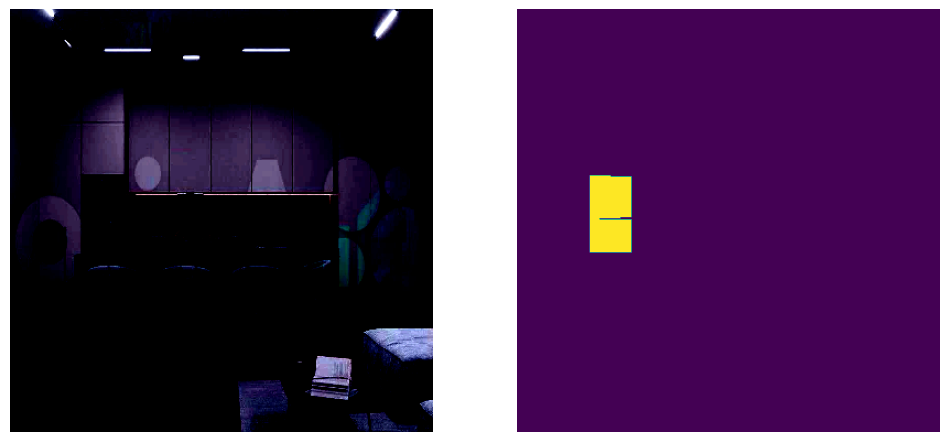

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


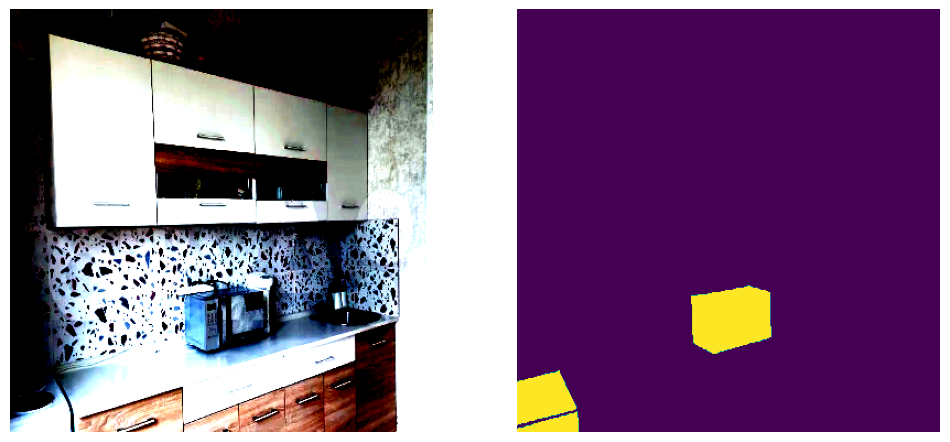

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


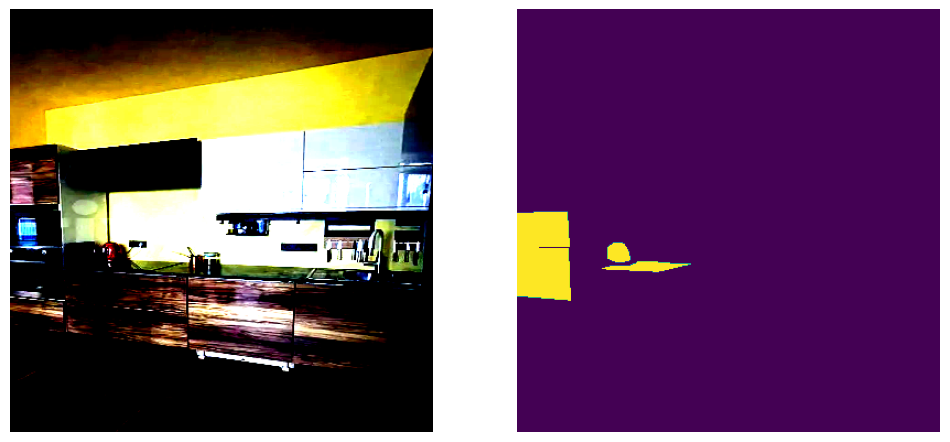

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


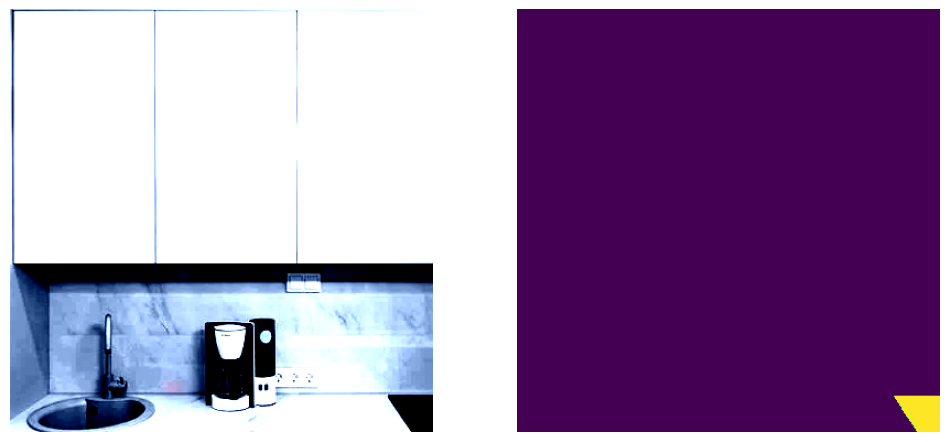

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


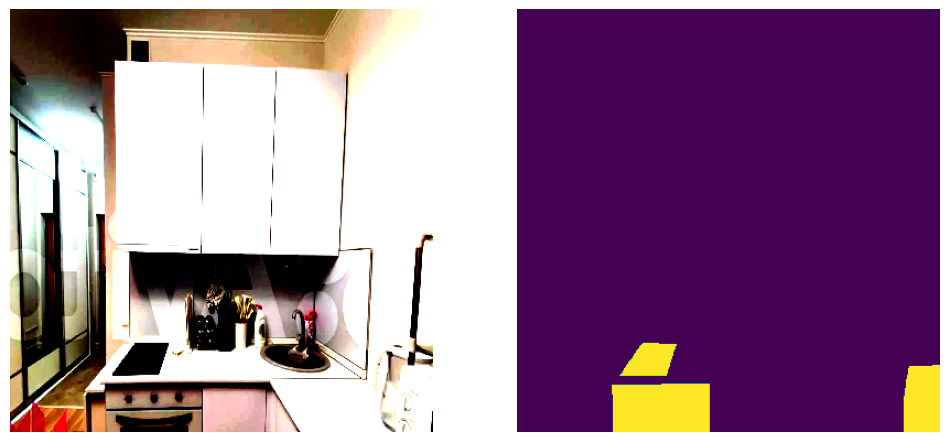

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


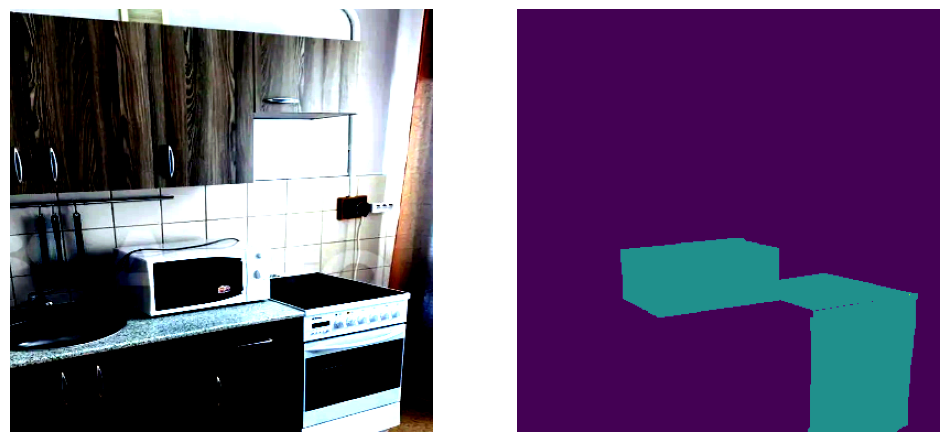

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


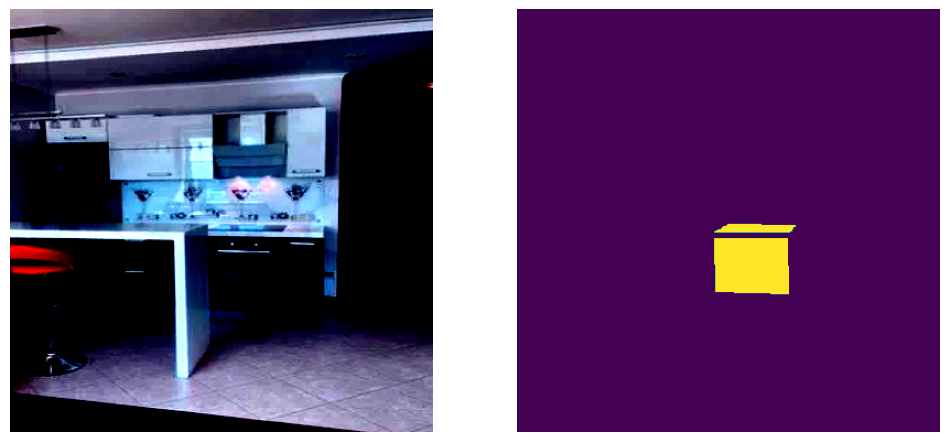

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


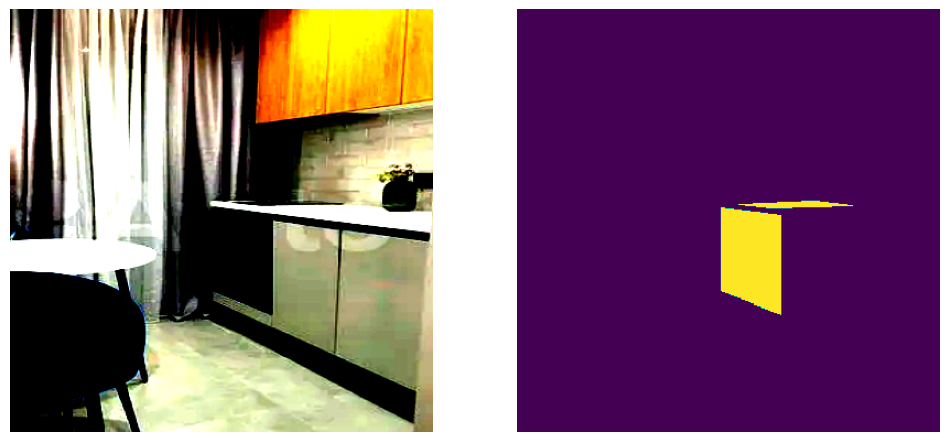

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


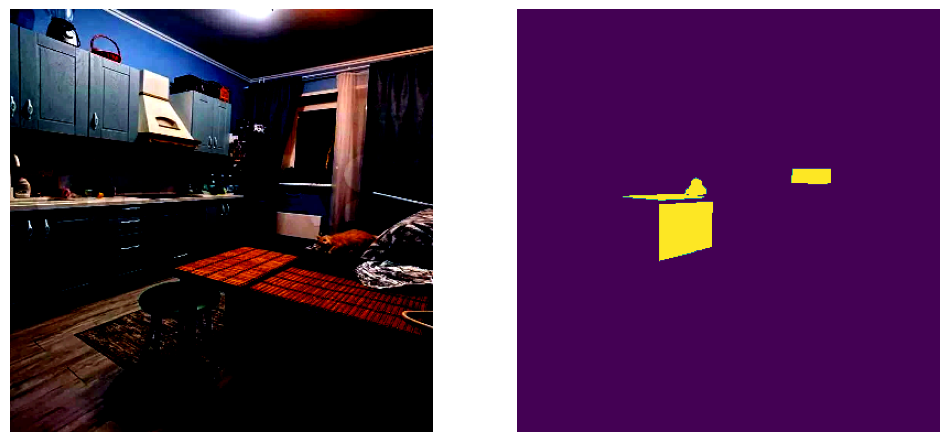

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


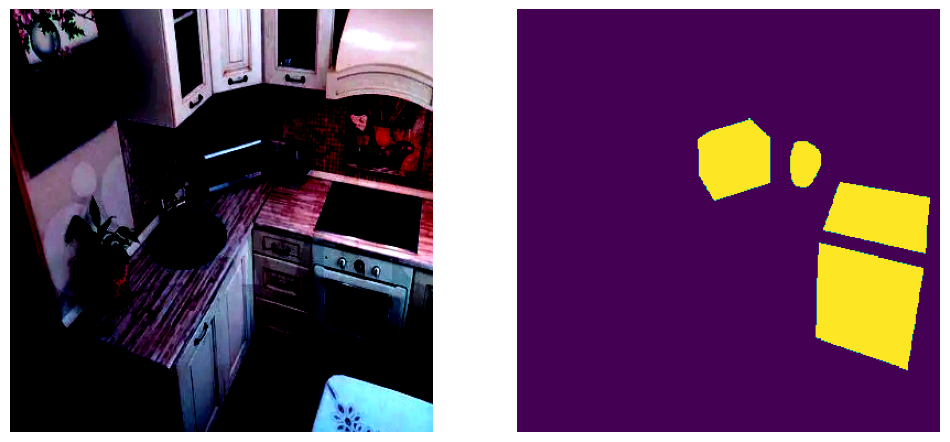

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


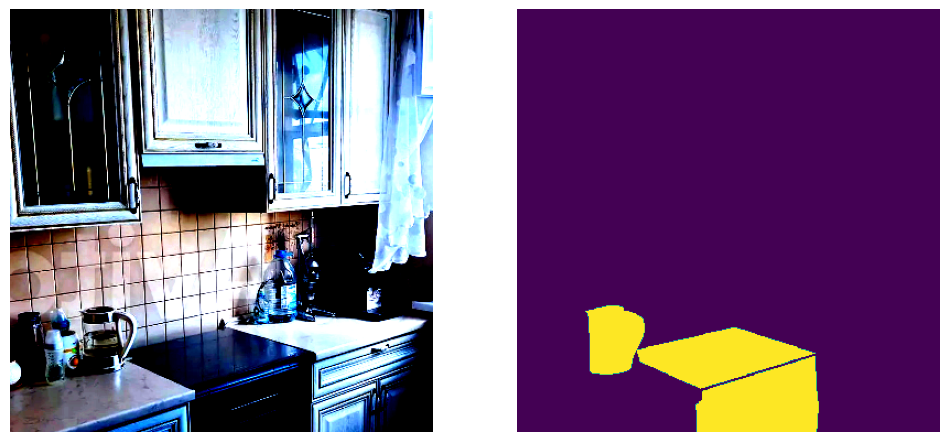

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


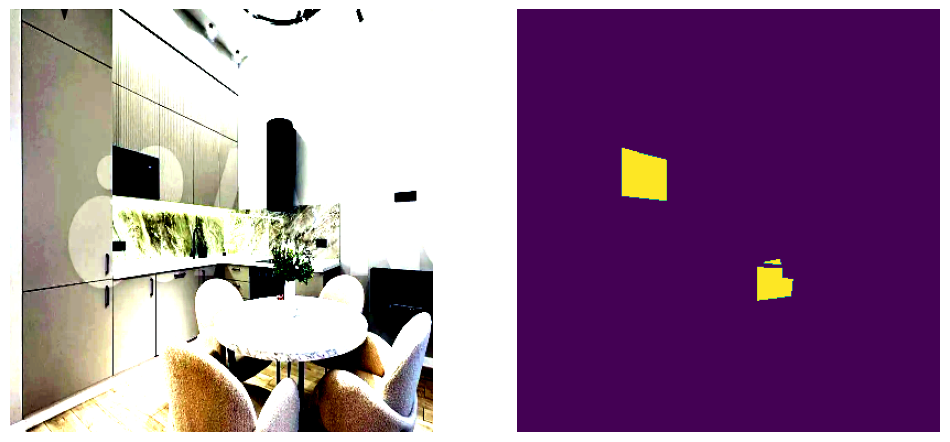

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


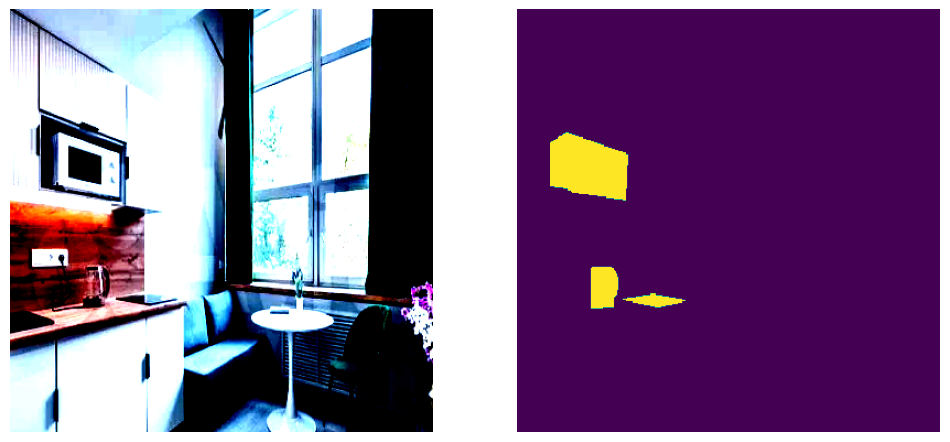

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


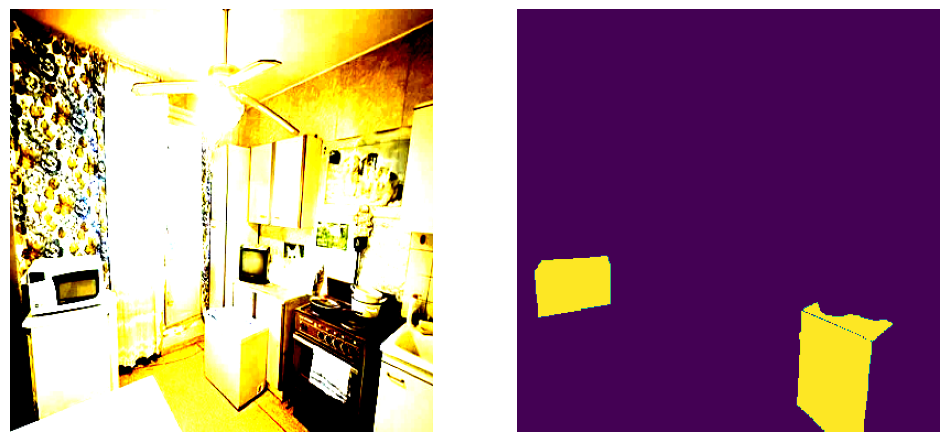

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


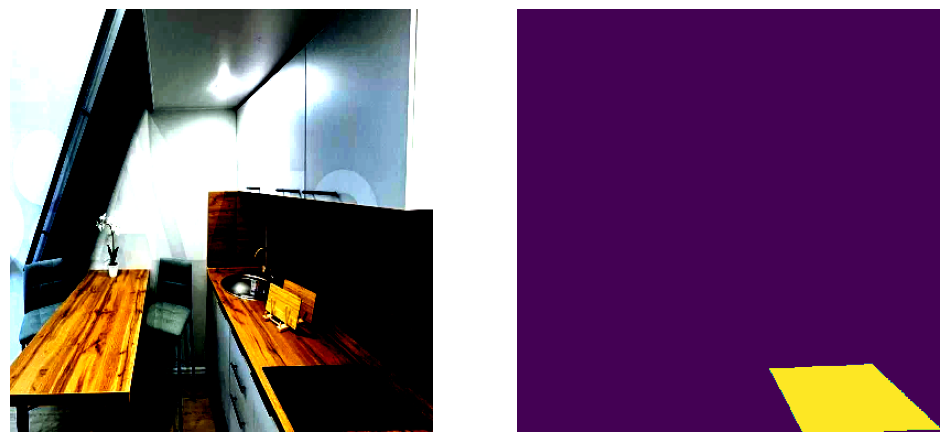

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


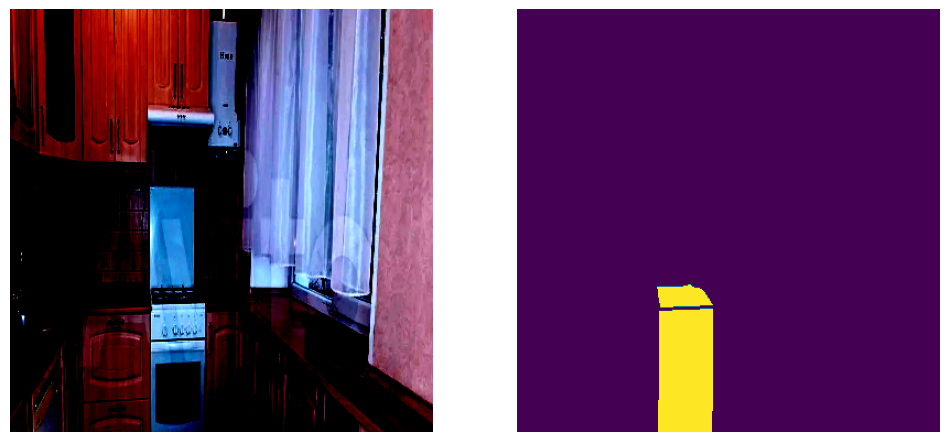

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


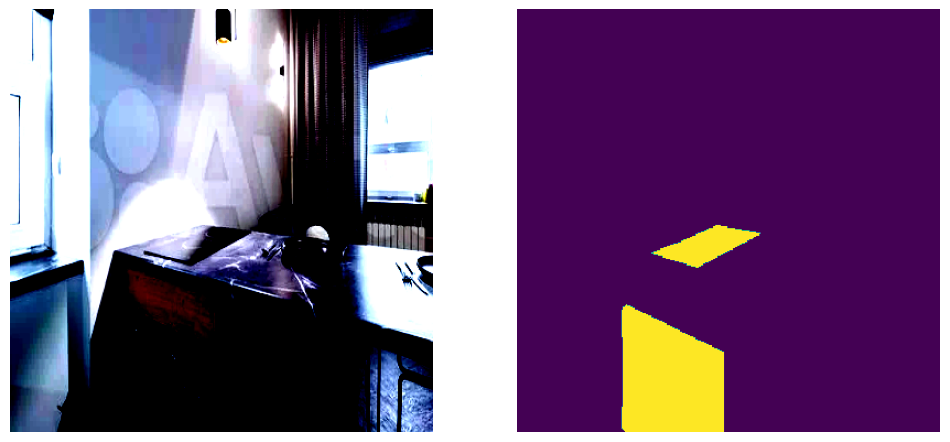

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


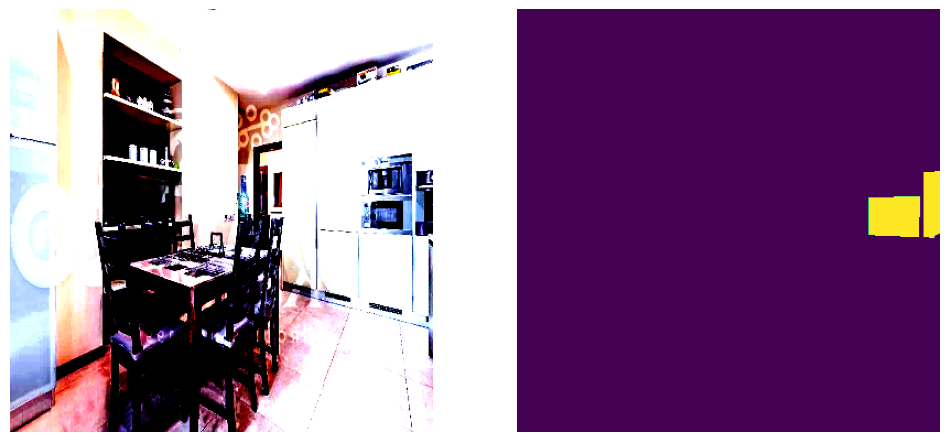

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


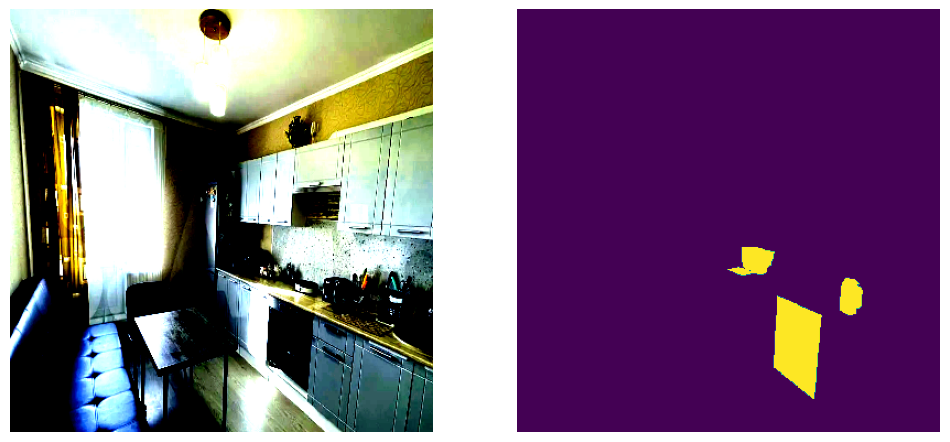

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


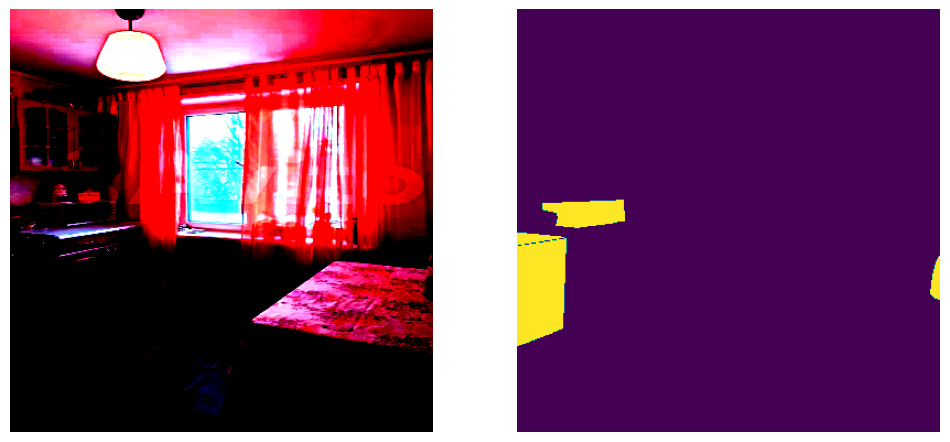

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


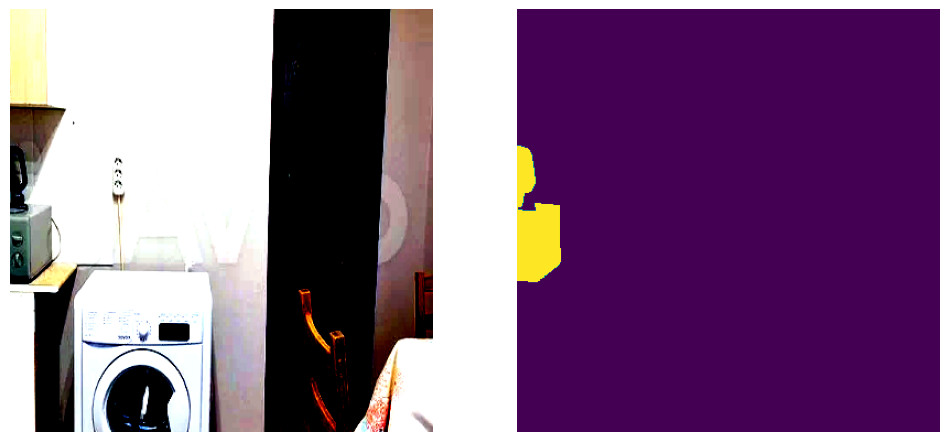

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


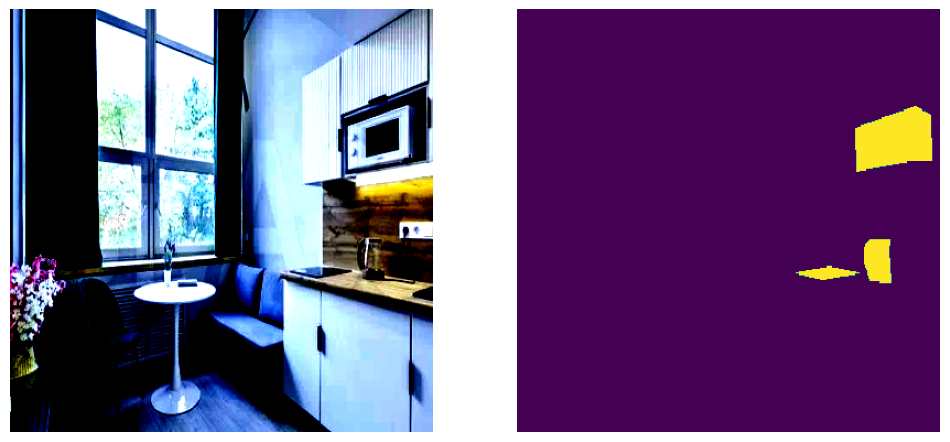

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


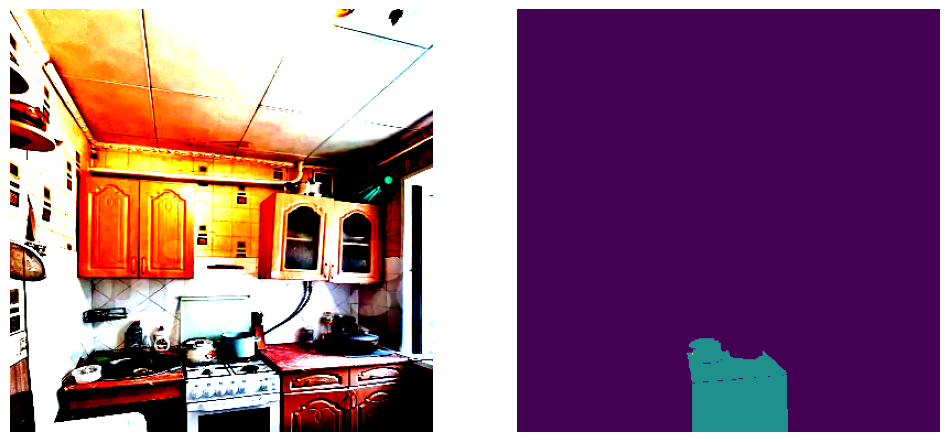

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


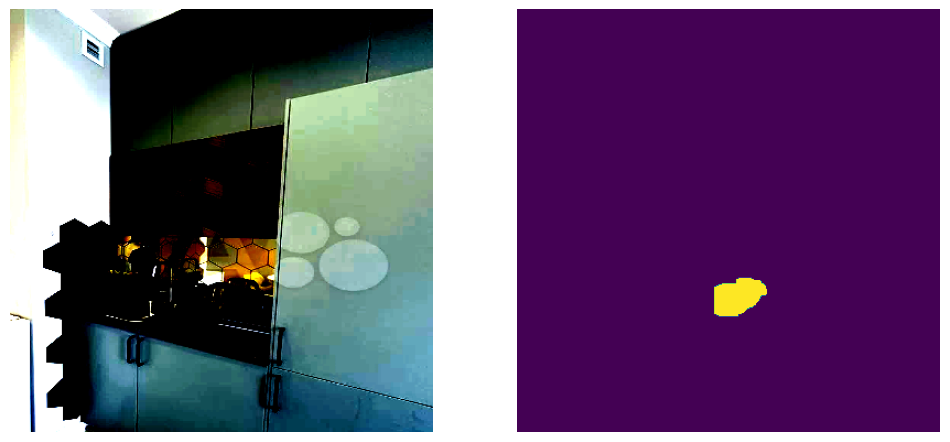

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


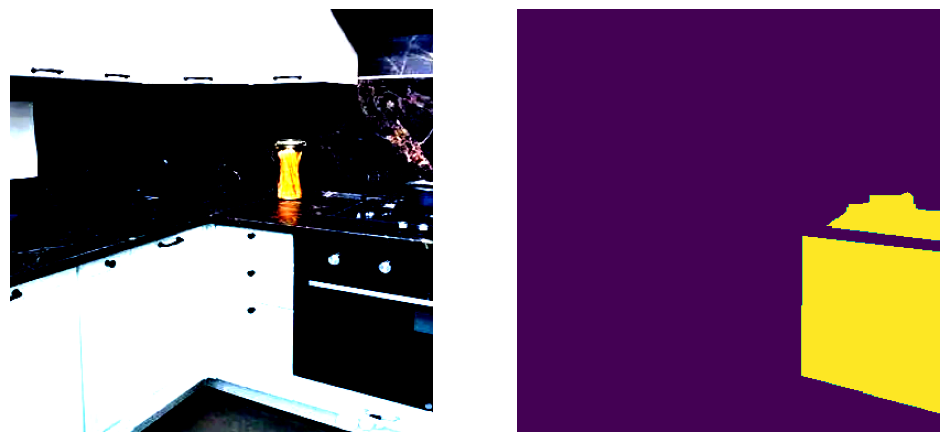

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


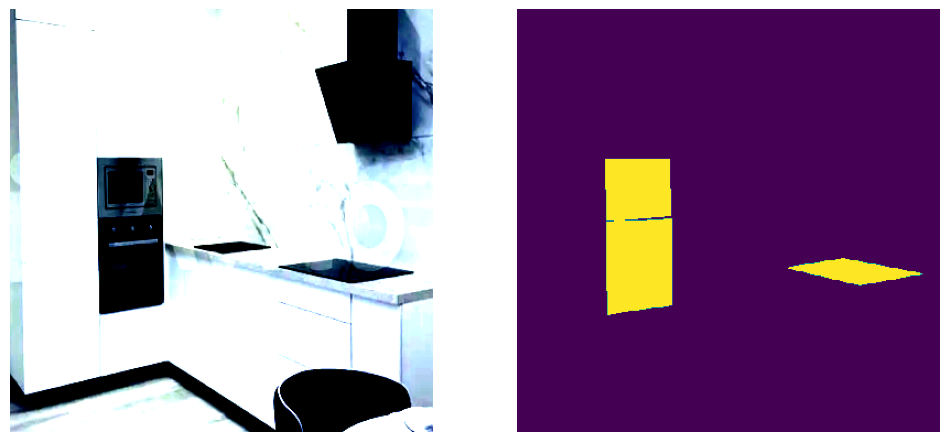

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


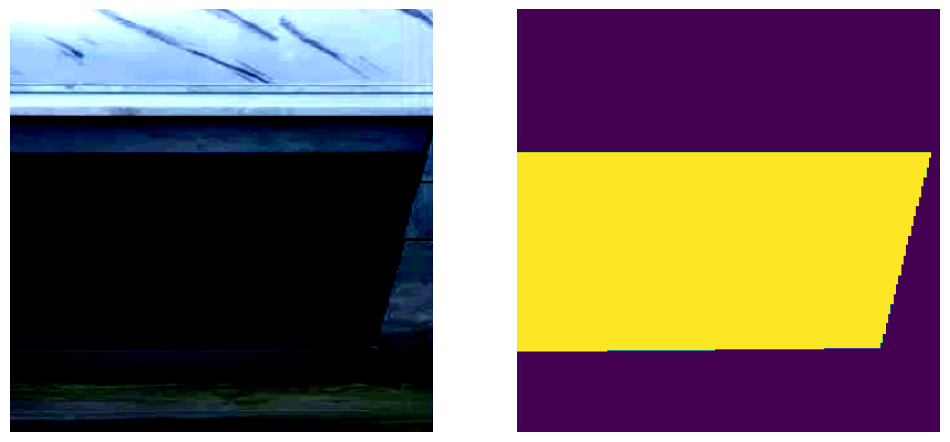

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


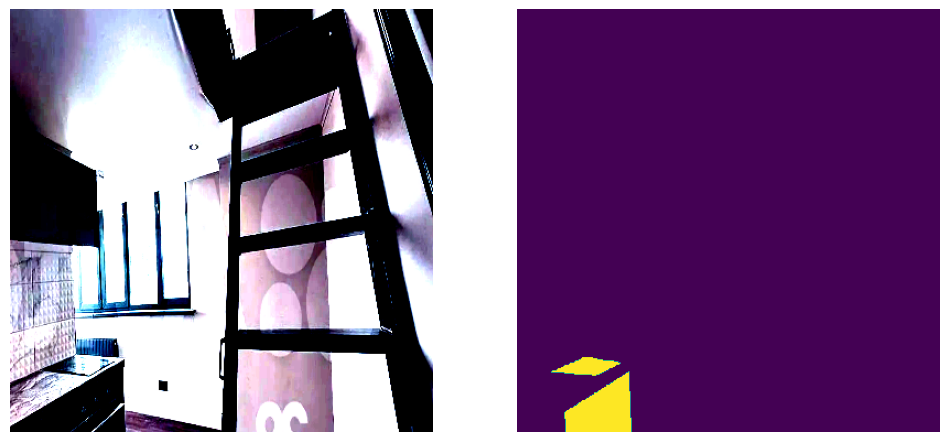

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


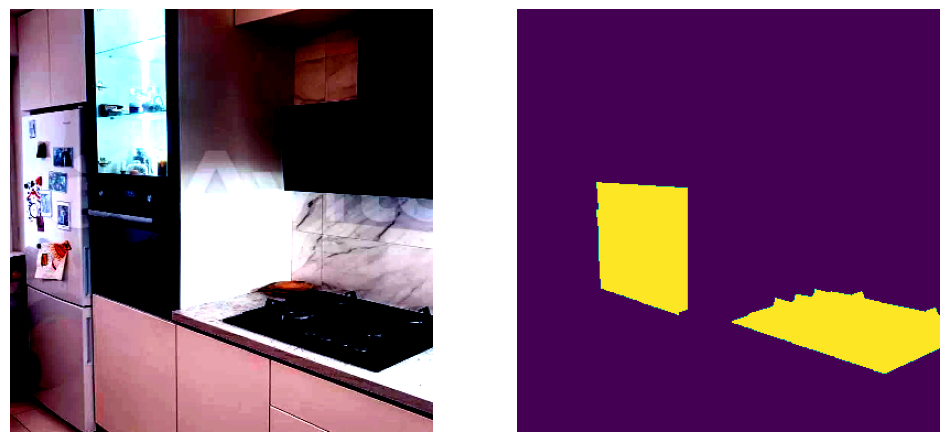

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


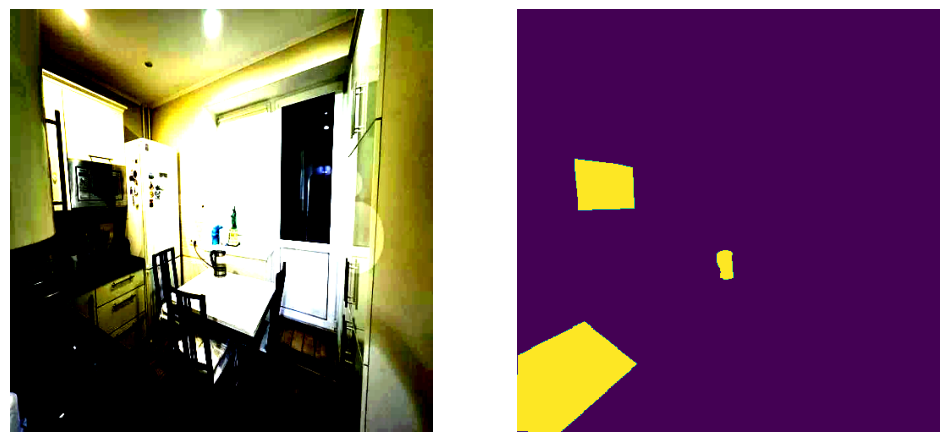

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


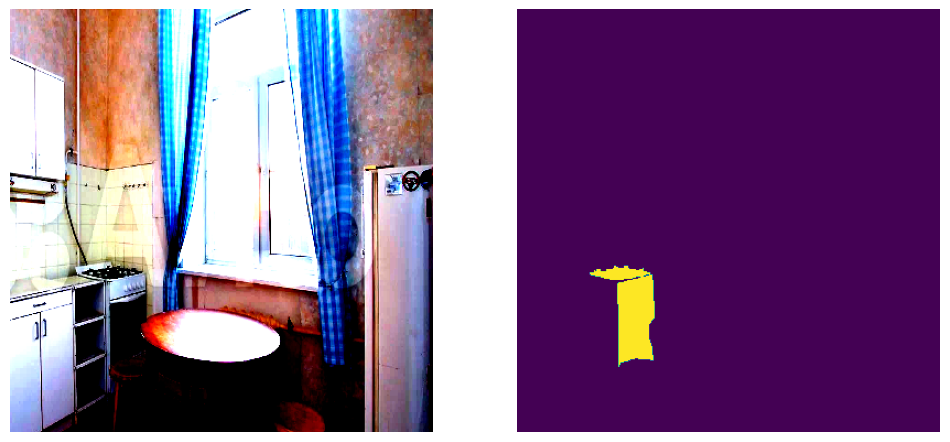

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


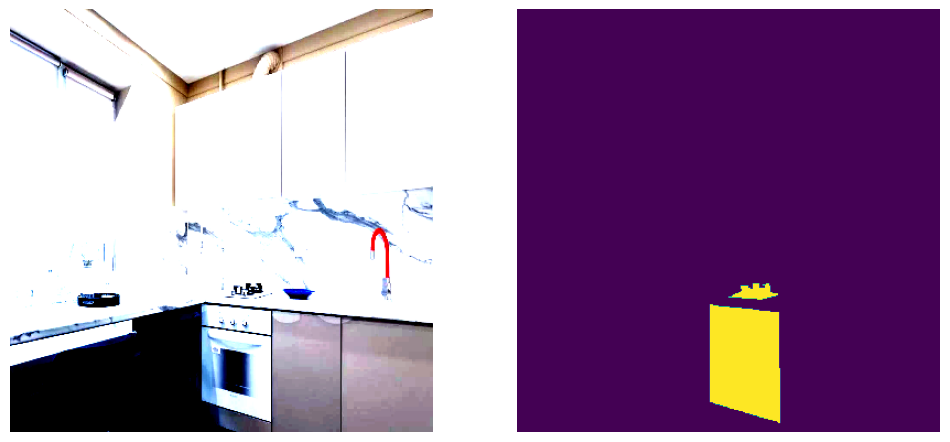

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


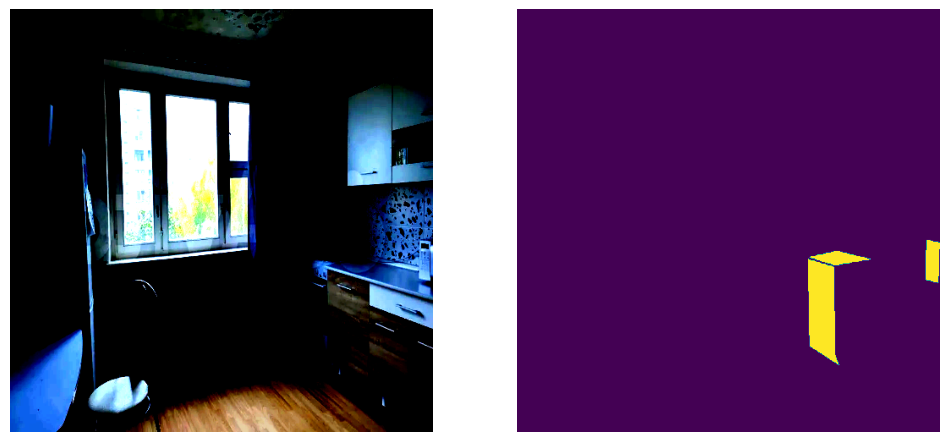

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


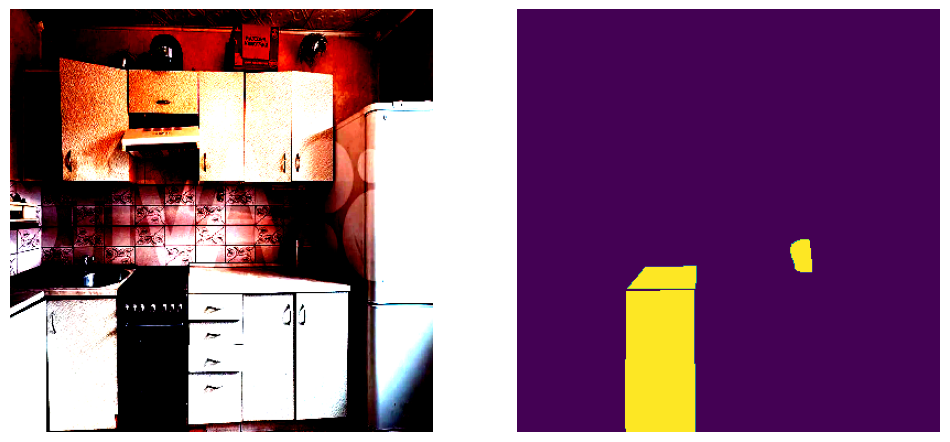

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


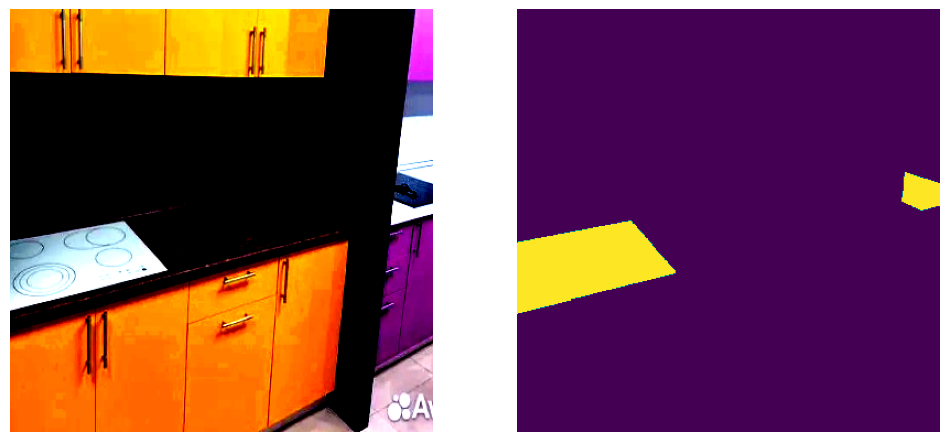

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


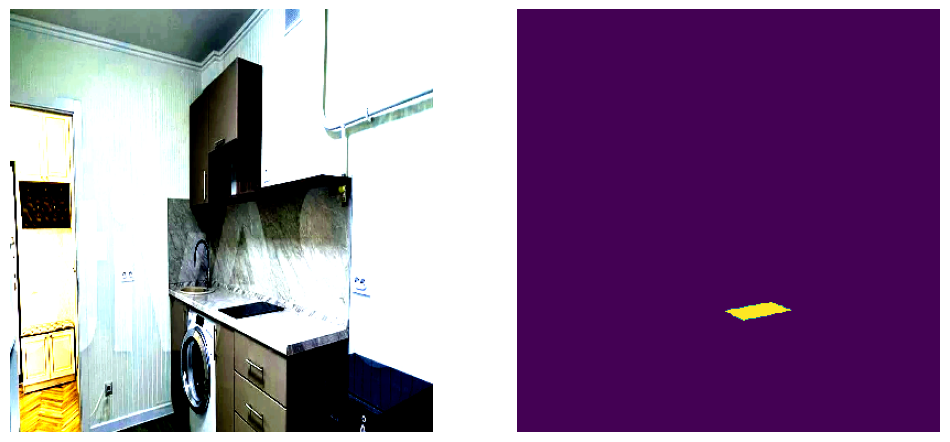

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


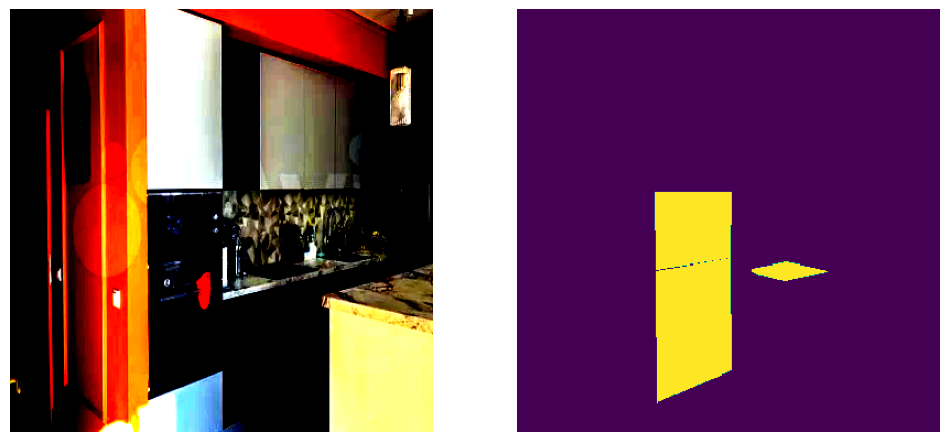

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


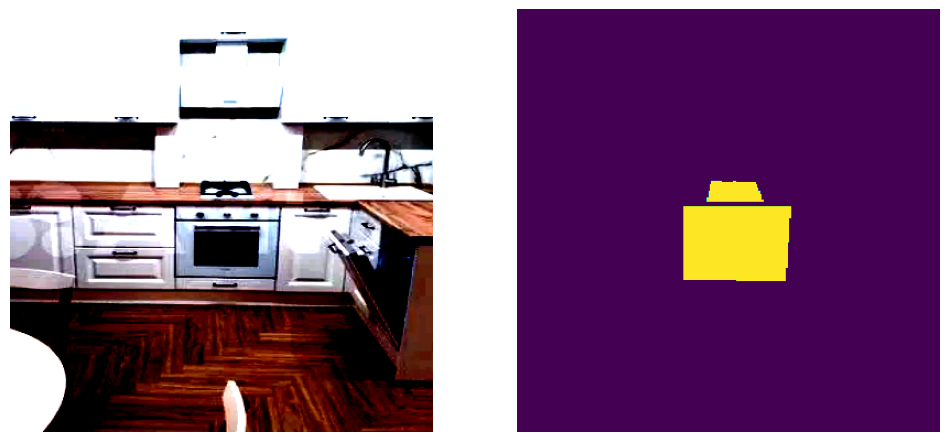

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


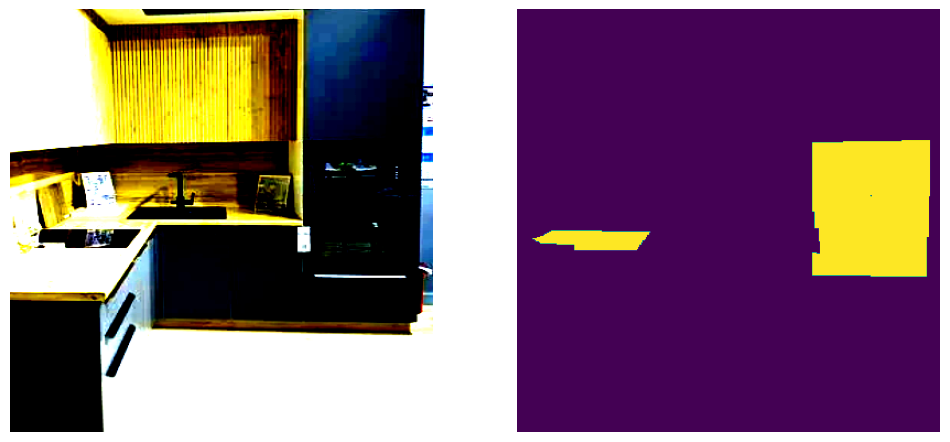

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


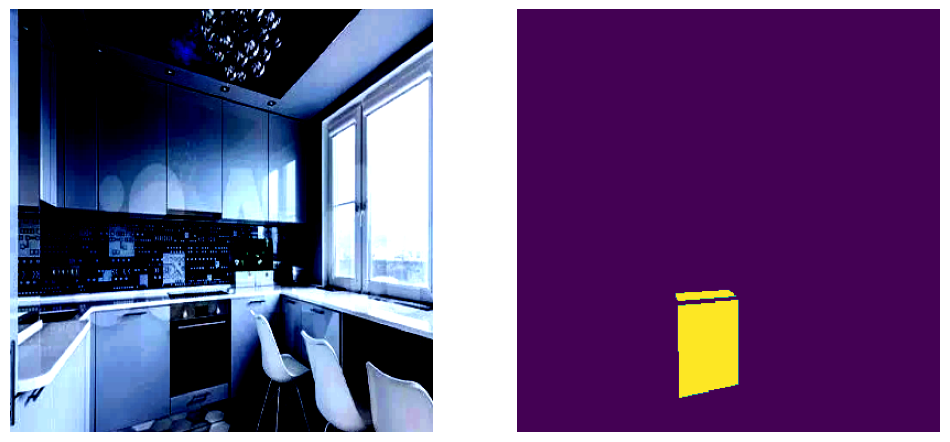

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


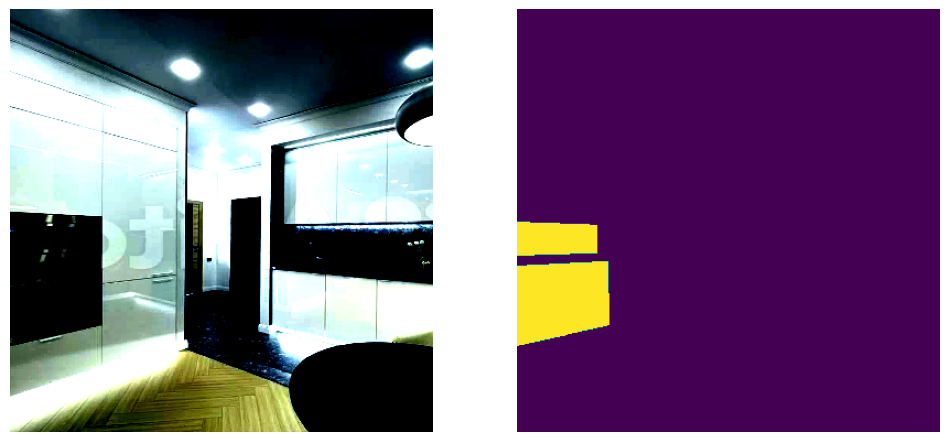

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


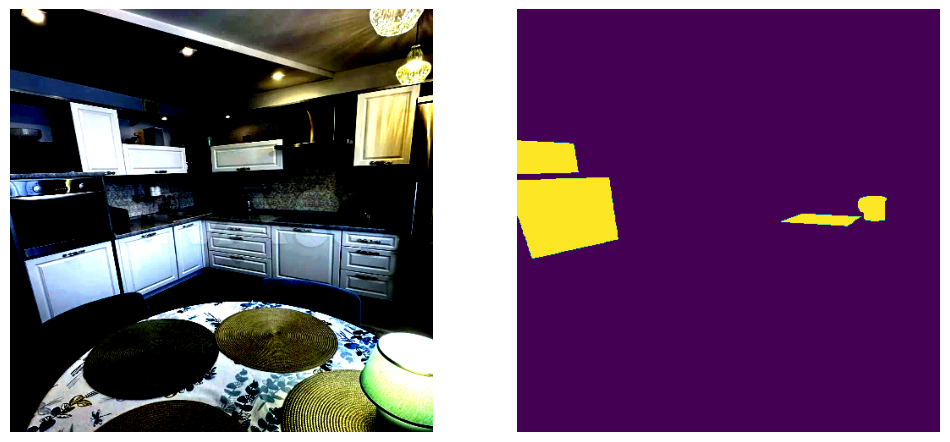

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


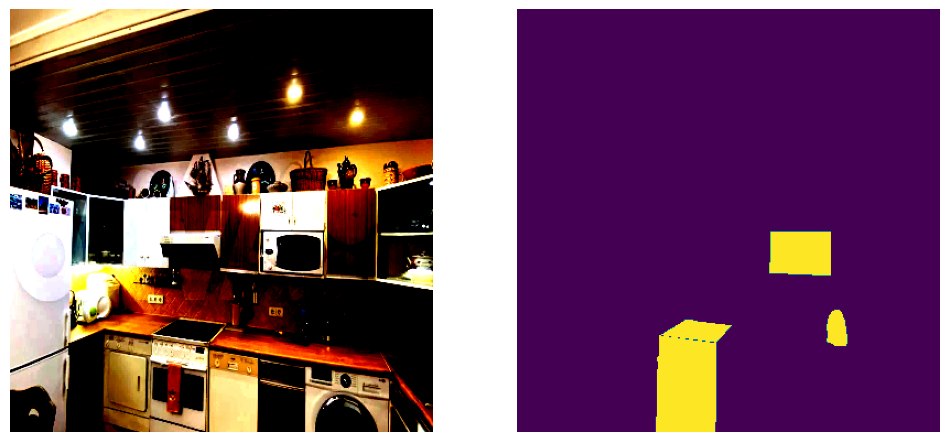

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


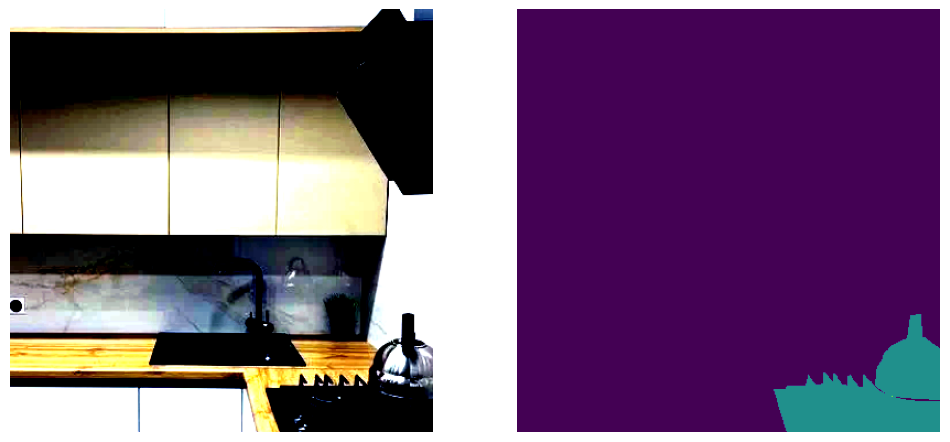

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


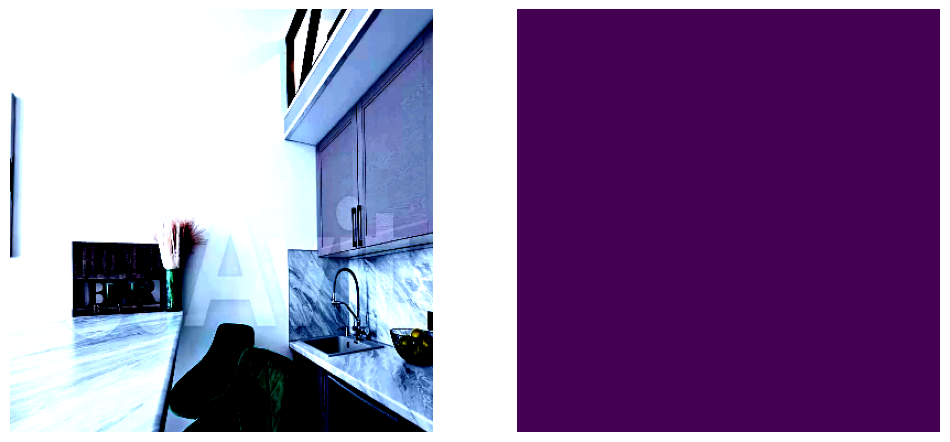

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


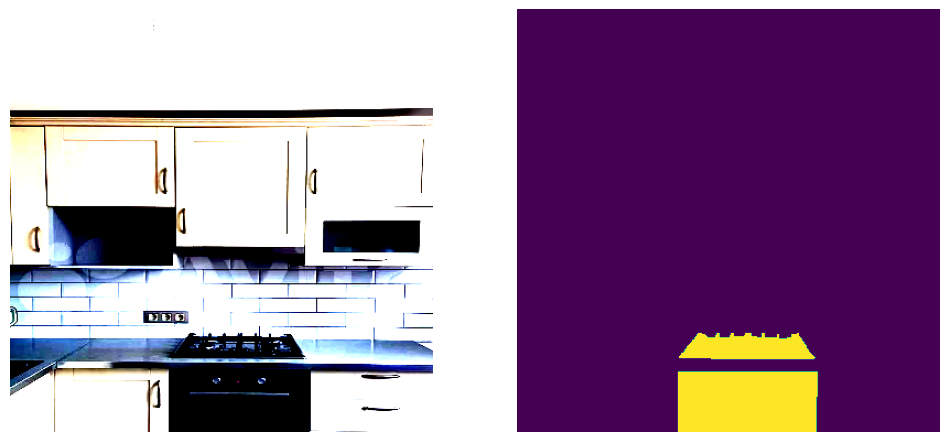

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


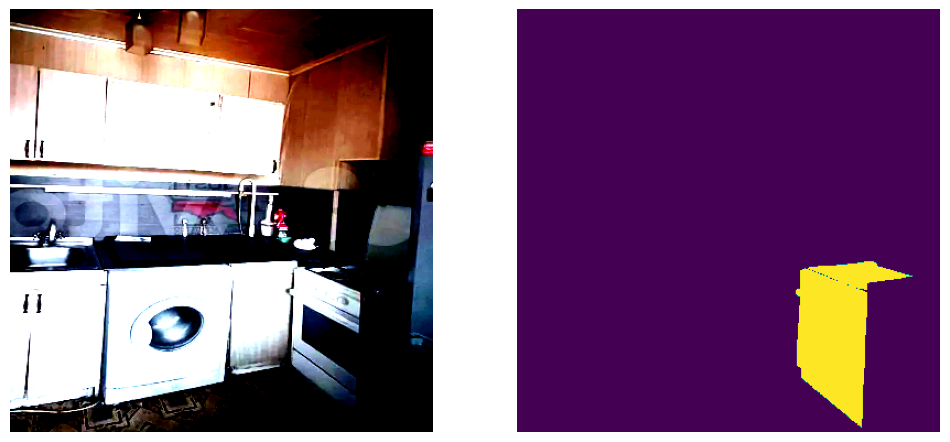

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


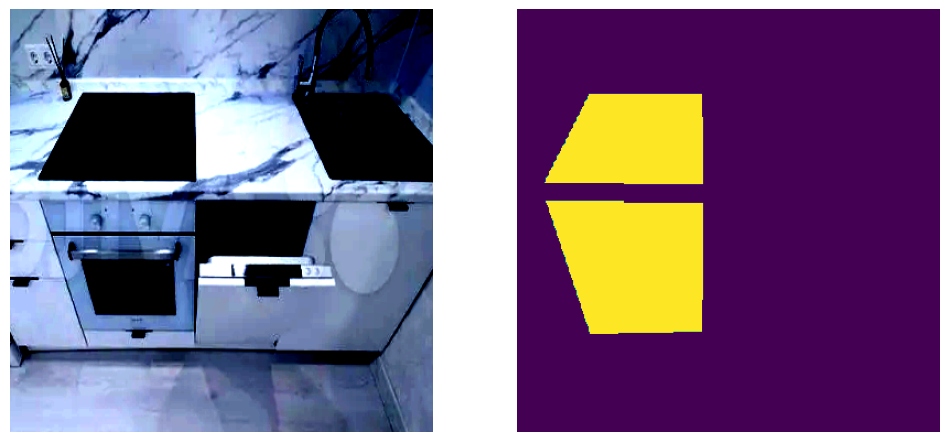

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


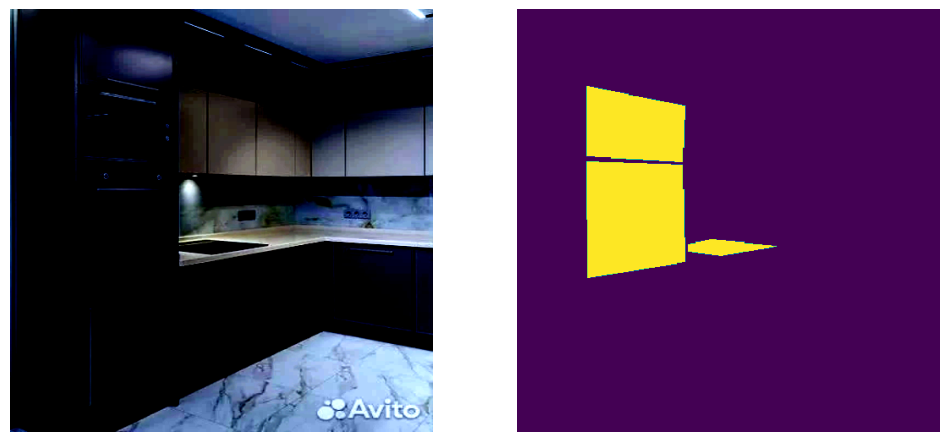

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


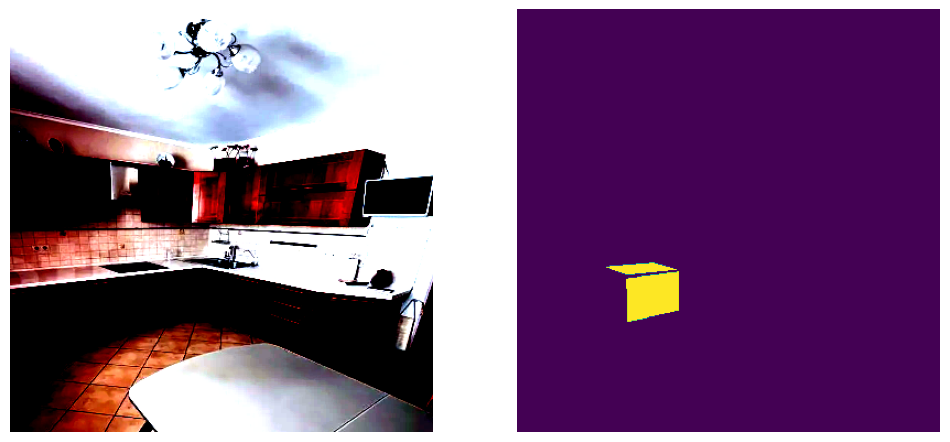

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


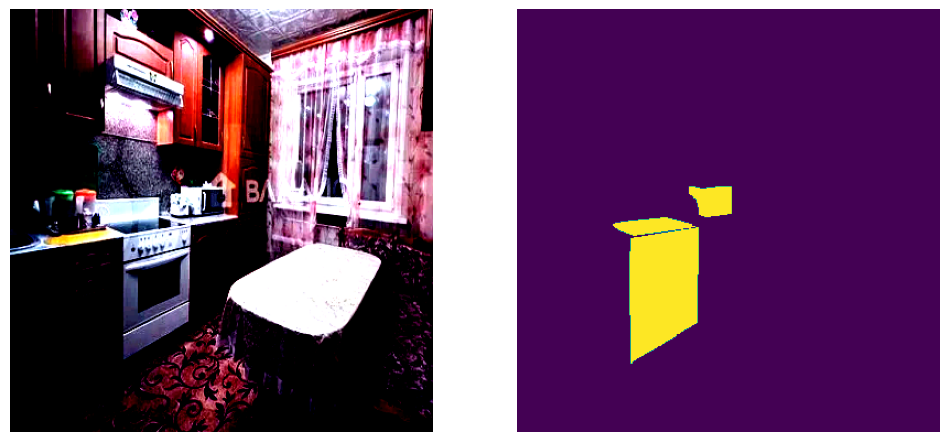

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


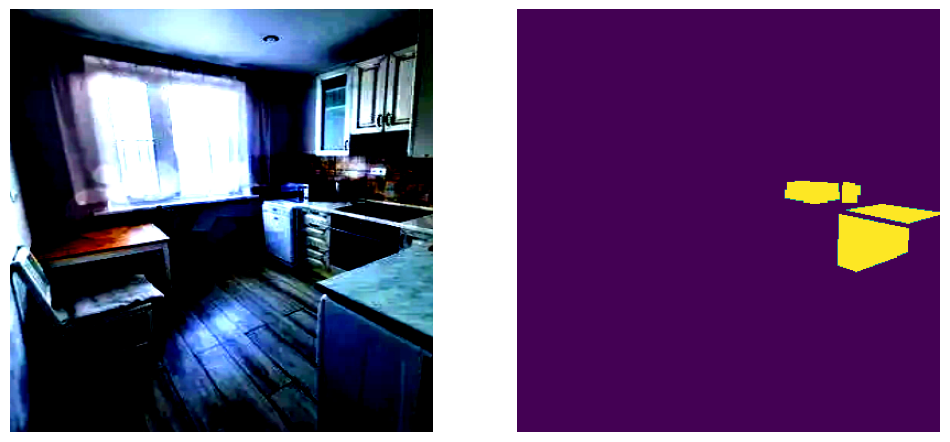

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


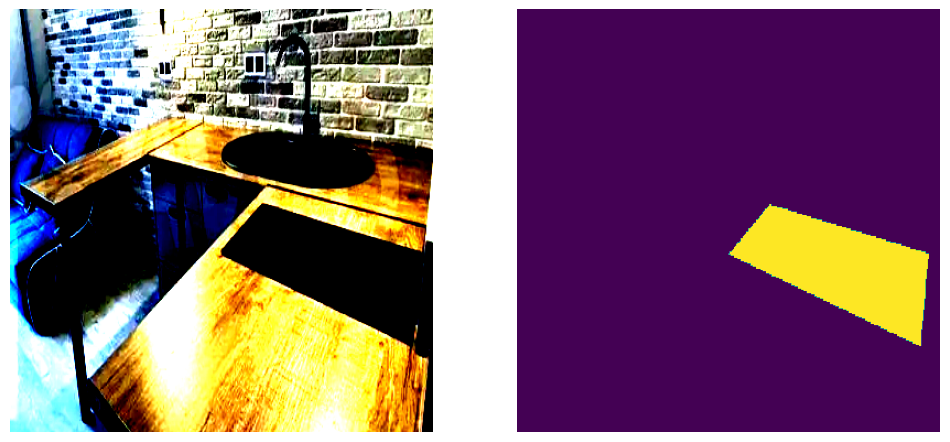

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


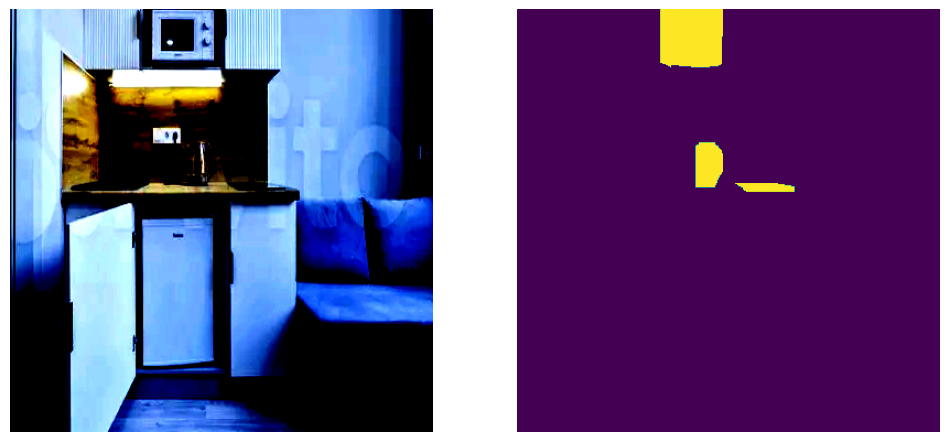

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


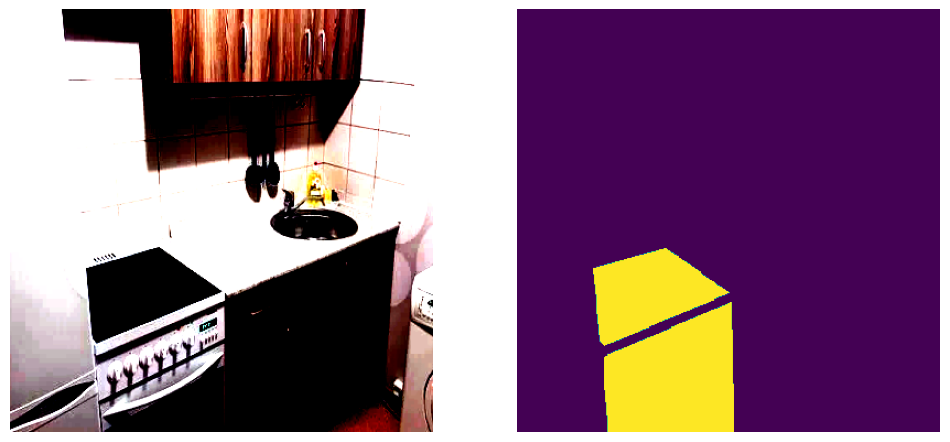

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


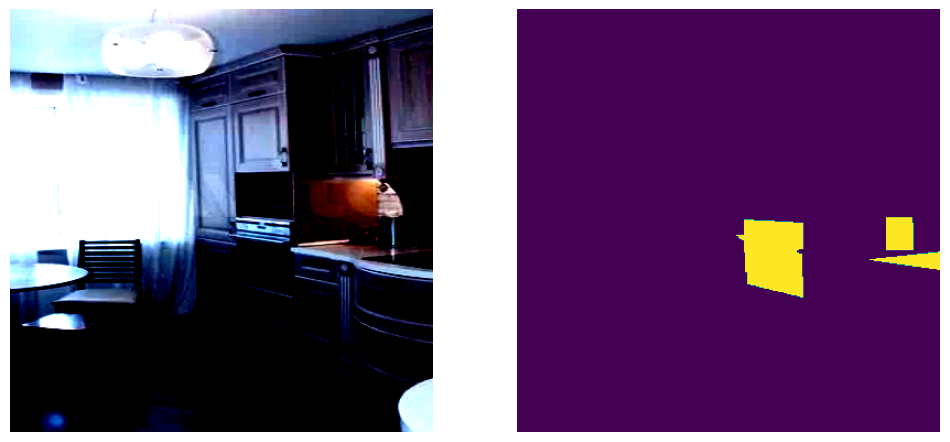

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


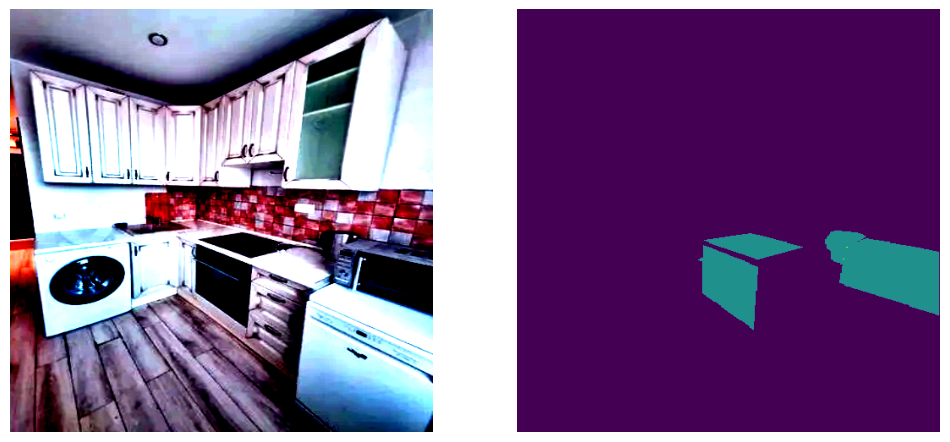

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


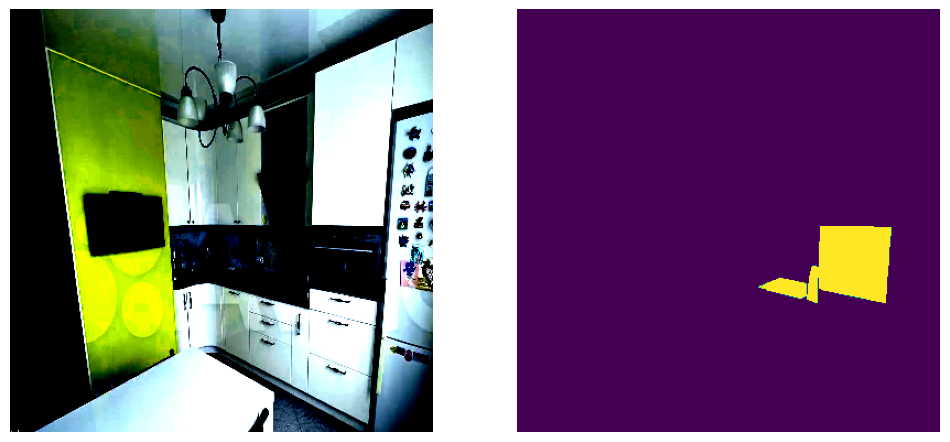

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


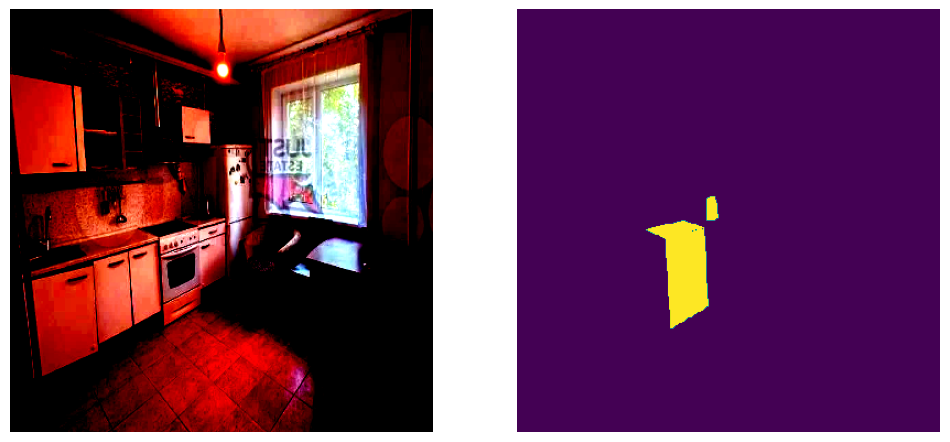

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


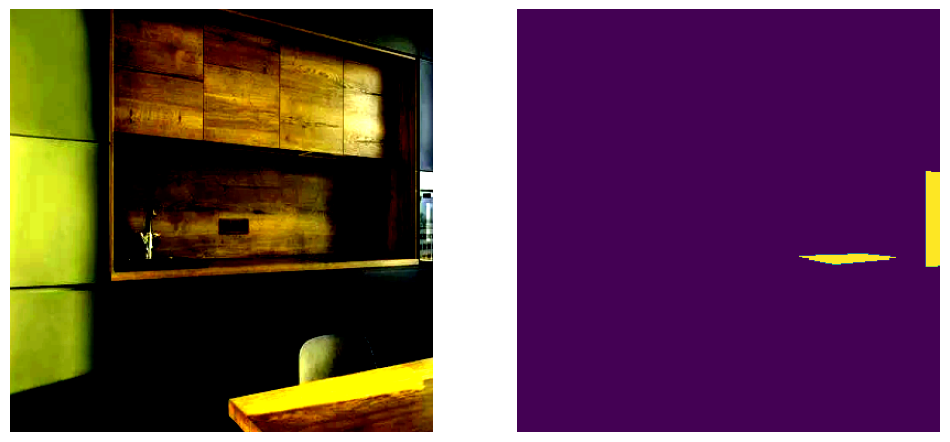

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


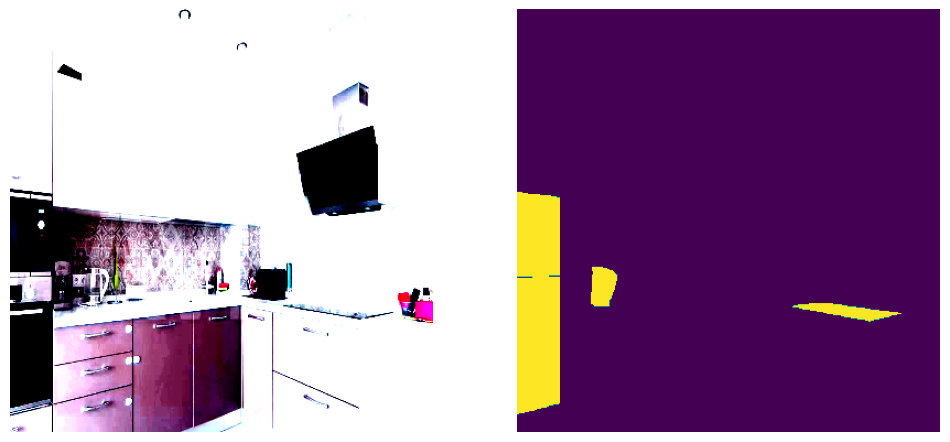

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


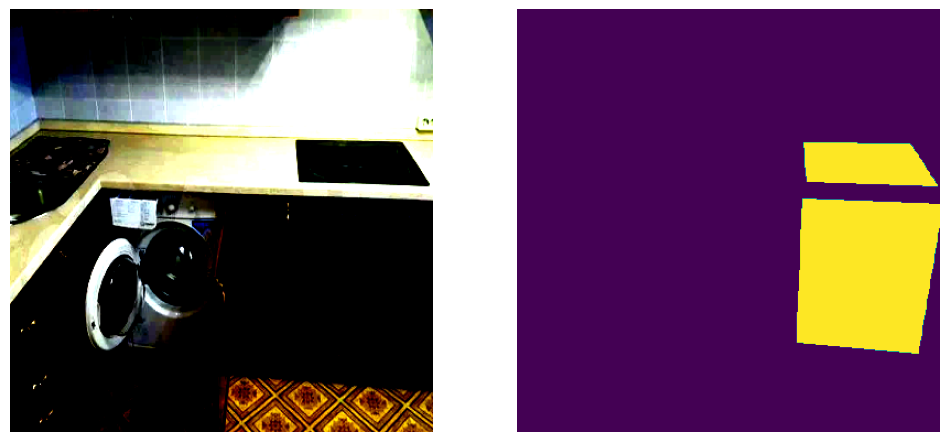

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


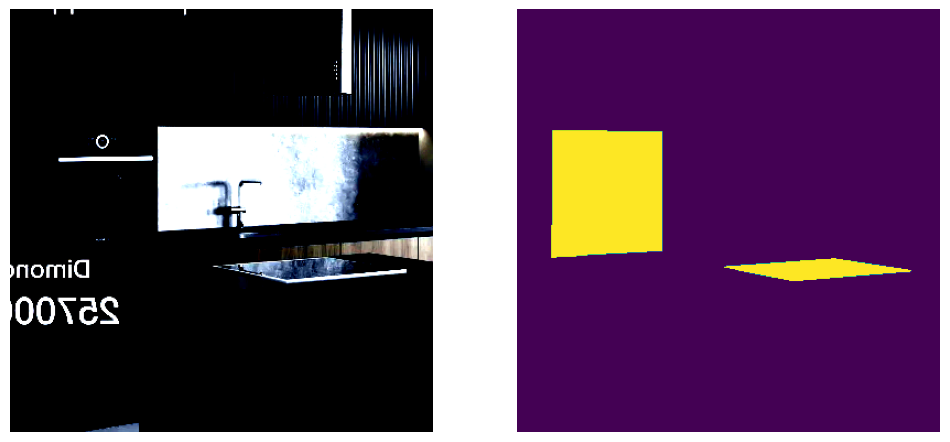

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


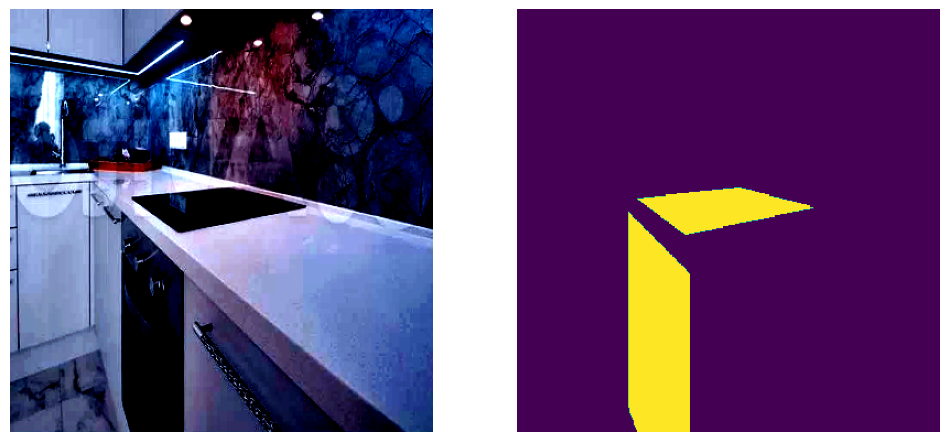

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


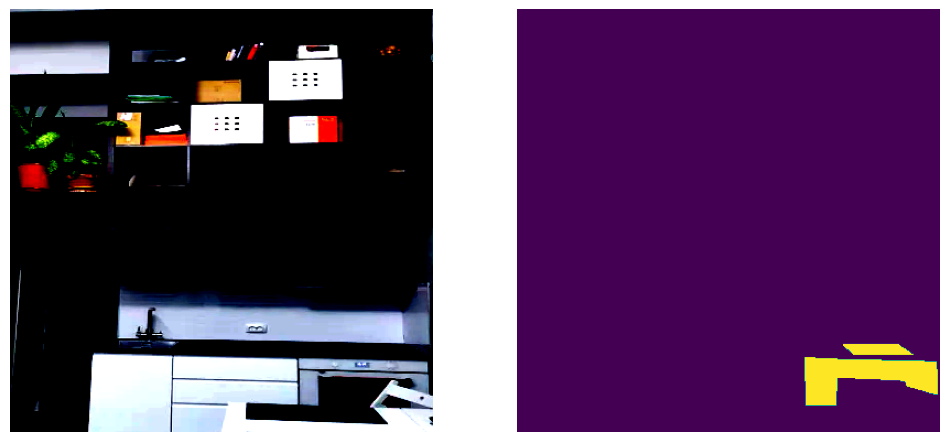

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


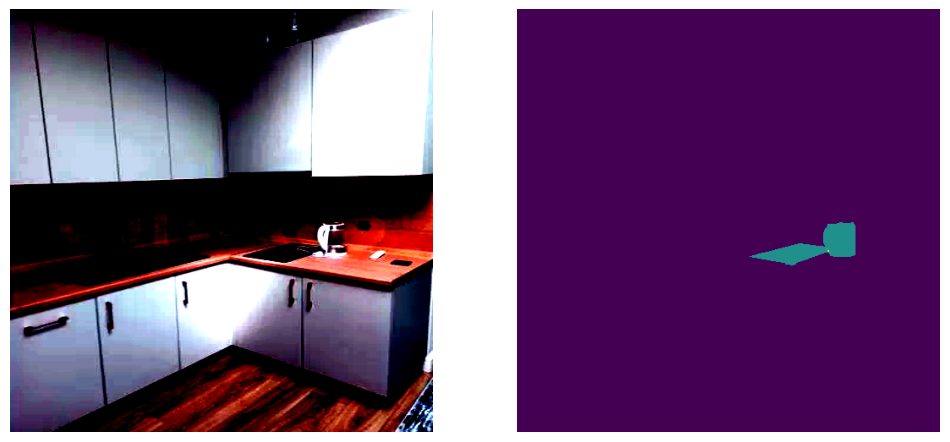

In [129]:
for i in range(len(img_path)):
    img = cv2.imread(img_path[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    mask = np.load(mask_path[i])

    transformed_data = train_transforms(image=img, mask=mask)
    transformed_img = transformed_data['image']
    transformed_mask = transformed_data['mask']
    plot_images_side_by_side(transformed_img, np.sum(transformed_mask, axis=-1))

In [9]:
transformed_mask.astype(np.float32)

array([[[0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        ...,
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.]],

       [[0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        ...,
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.]],

       [[0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        ...,
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.]],

       ...,

       [[0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 1., 0., 0.],
        ...,
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.]],

       [[0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 1., 0., 0.],
        ...,
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.]],

       [[0., 0., 0., 0.],
        [0., 0., 0., 0.],
        [0., 0., 0., 0.],
        ...,
        [0., 0., 0., 0.],
        [0., 0.

In [10]:
set_seed()

In [11]:
all_train_images = sorted(glob.glob('data/train/images/*.jpg'))
all_train_masks = sorted(glob.glob('data/train/masks/*.npy'))

train_images, valid_images, train_masks, valid_masks = train_test_split(
    all_train_images,
    all_train_masks,
    test_size=0.2,
    random_state=42
)

all_test_images = sorted(glob.glob('data/test/images/*.jpg'))

len(train_images), len(train_masks), len(valid_images), len(valid_masks), len(all_test_images)

(96, 96, 24, 24, 37)

In [12]:
train_dataset = SegmentationDataset(
    train_images, 
    train_masks,
    train_transforms
)

valid_dataset = SegmentationDataset(
    valid_images, 
    valid_masks,
    test_transforms
)

train_loader = DataLoader(train_dataset, BATCH_SIZE, num_workers=0, shuffle=True)
valid_loader = DataLoader(valid_dataset, BATCH_SIZE, num_workers=0, shuffle=False)

print(len(train_dataset), len(valid_dataset))

96 24


# Baseline

In [16]:
model = smp.UnetPlusPlus(
    encoder_name='efficientnet-b2',
    encoder_weights='imagenet',
    classes=4,
).to(device)

loss_fn = ComboLoss(weights={'bce': 0.65, 'dice': 0.35}, channel_weights=[1]*4)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5)
optimizer.param_groups[0]['initial_lr'] = optimizer.param_groups[0]['lr']
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer,
                                                       eta_min=5e-5,
                                                       T_max=40,
                                                       last_epoch=39)

In [19]:
# best_score = 0
optimizer.param_groups[0]['lr'] = 5e-6
for epoch in range(40):
    train_loss = train_epoch(train_loader, model, loss_fn, optimizer, device)
    valid_score = valid_epoch(valid_loader, model, device)
#     scheduler.step(train_loss)
    if valid_score > best_score:
        torch.save(model.state_dict(), 'best_model_unetPlusPlus_efnB2_2.pth')
        best_score = valid_score
    print(f'Epoch: {epoch}, train_loss: {train_loss:.4f}, valid_score: {valid_score:.3f}\n')

Epoch: 0, train_loss: 0.4026, valid_score: 0.568

Epoch: 1, train_loss: 0.4137, valid_score: 0.571

Epoch: 2, train_loss: 0.3842, valid_score: 0.568

Epoch: 3, train_loss: 0.3708, valid_score: 0.570

Epoch: 4, train_loss: 0.4236, valid_score: 0.575

Epoch: 5, train_loss: 0.3829, valid_score: 0.577

Epoch: 6, train_loss: 0.3798, valid_score: 0.571

Epoch: 7, train_loss: 0.4088, valid_score: 0.570

Epoch: 8, train_loss: 0.4025, valid_score: 0.572

Epoch: 9, train_loss: 0.3992, valid_score: 0.580

Epoch: 10, train_loss: 0.3596, valid_score: 0.579

Epoch: 11, train_loss: 0.3821, valid_score: 0.580

Epoch: 12, train_loss: 0.3762, valid_score: 0.569

Epoch: 13, train_loss: 0.3745, valid_score: 0.577

Epoch: 14, train_loss: 0.3665, valid_score: 0.569

Epoch: 15, train_loss: 0.3928, valid_score: 0.570

Epoch: 16, train_loss: 0.4140, valid_score: 0.571

Epoch: 17, train_loss: 0.3948, valid_score: 0.571

Epoch: 18, train_loss: 0.4049, valid_score: 0.572

Epoch: 19, train_loss: 0.4254, valid_scor

In [20]:
model.load_state_dict(torch.load('best_model_unetPlusPlus_efnB2_2.pth'))

best_score = valid_epoch(valid_loader, model, device)
print(f'Best validation score: {best_score}')

/var/folders/xh/6dy3_1zs7yq6xhg9zym7x2100000gn/T/ipykernel_20339/1831069613.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('best_model_

Best validation score: 0.596998929977417


In [21]:
valid_image_path = sorted(valid_images)[7]

with torch.no_grad():
    img = cv2.imread(valid_image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    transformed_data = test_transforms(image=img)
    transformed_img = transformed_data['image']
    model_input = torch.from_numpy(transformed_img).permute(2, 0, 1).unsqueeze(0)
    pred = model(model_input.to(device))
    mask = torch.sigmoid(pred).squeeze().cpu() > 0.5
    resized_mask = cv2.resize(
        mask.numpy().transpose((1, 2, 0)).astype(int),
        (img.shape[1], img.shape[0]),
        interpolation=cv2.INTER_NEAREST
    )

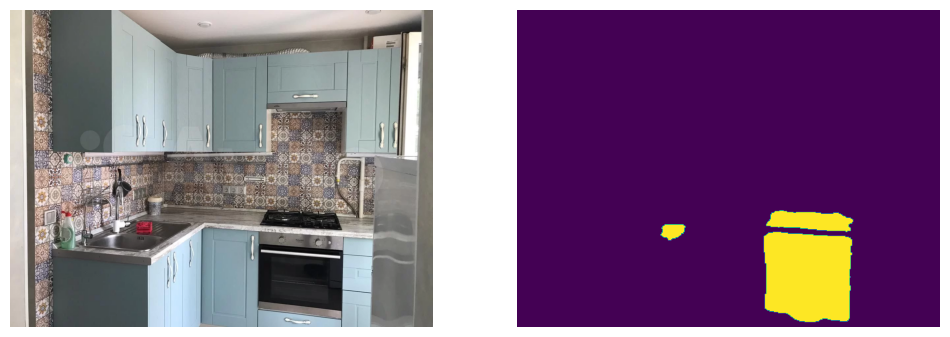

In [22]:
plot_images_side_by_side(img, resized_mask.sum(2, keepdims=True))

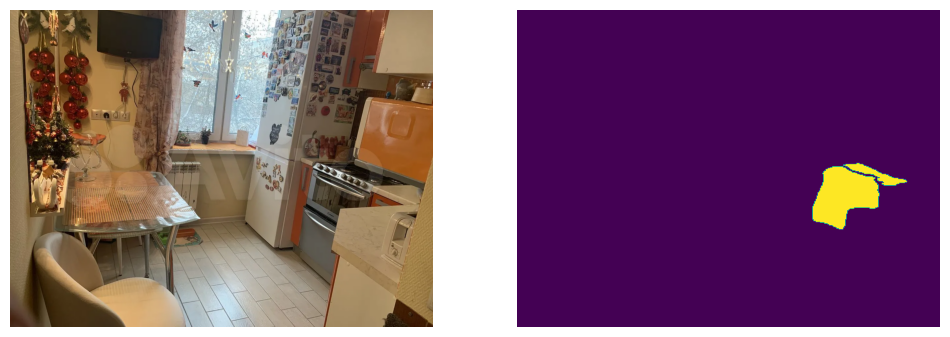

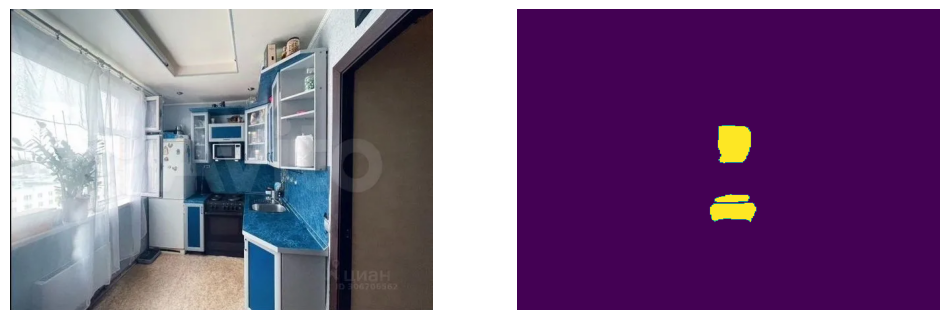

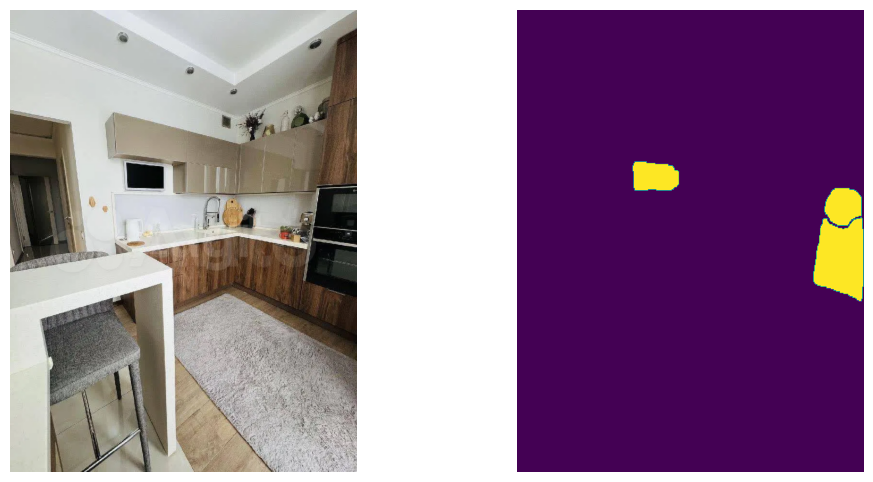

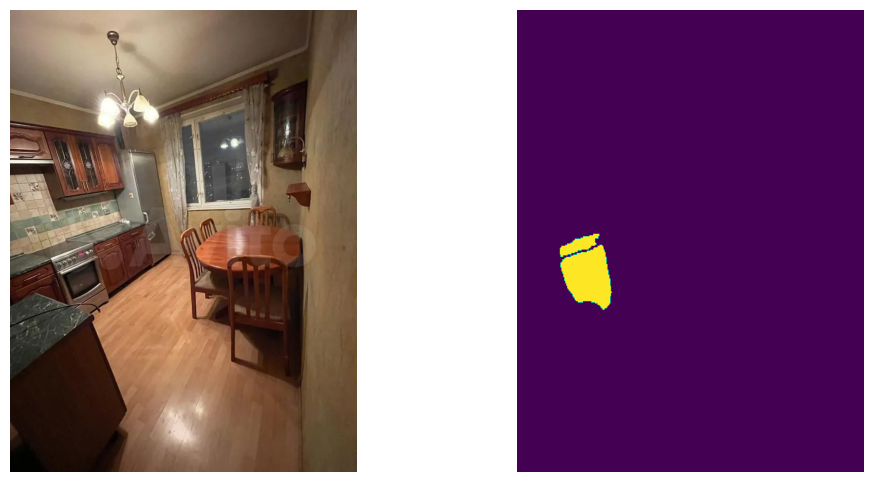

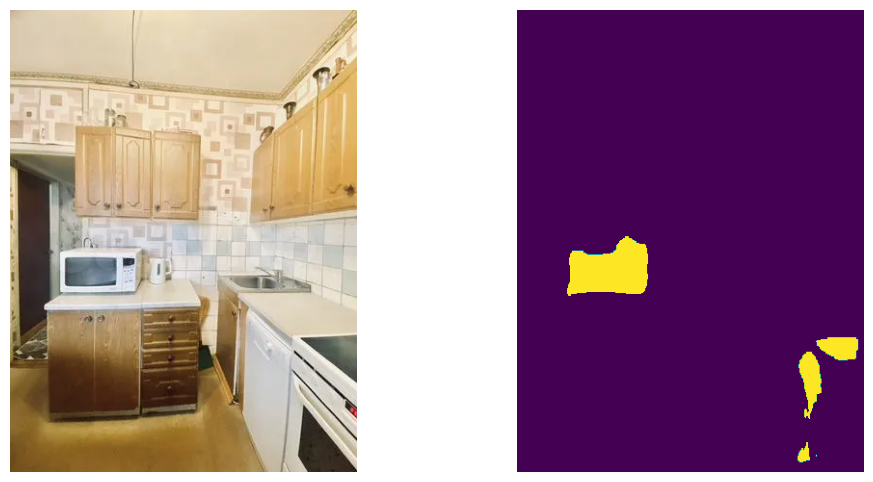

...

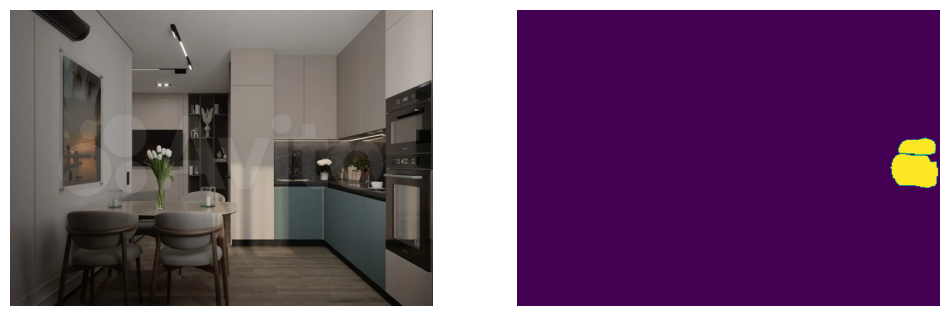

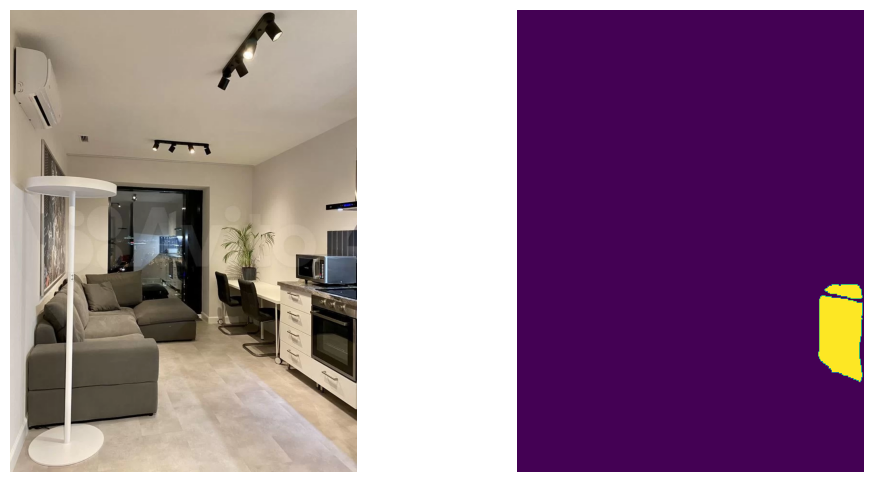

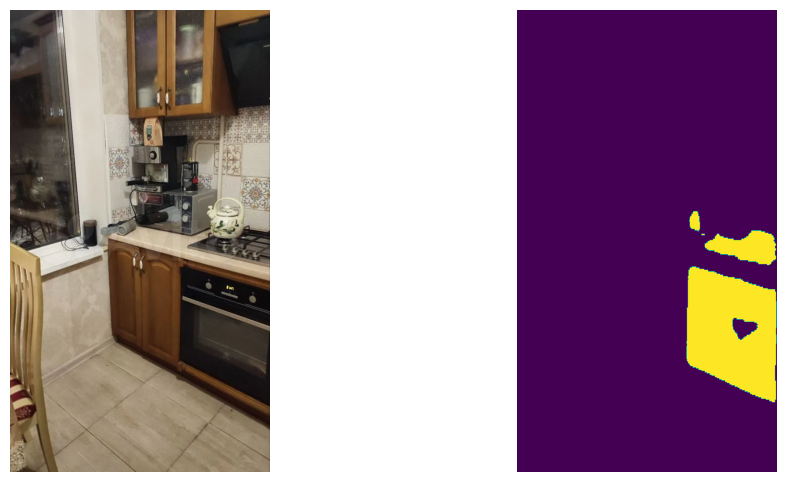

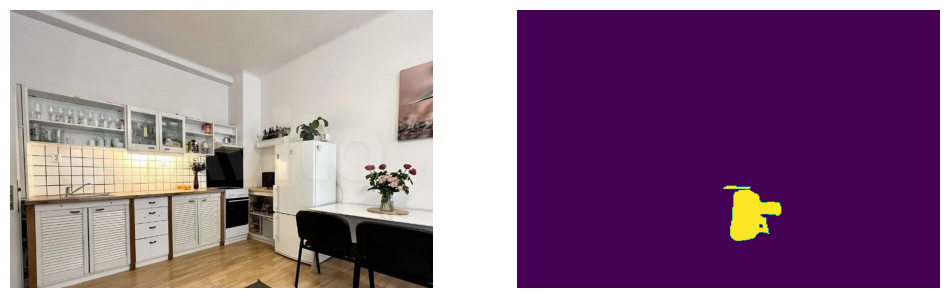

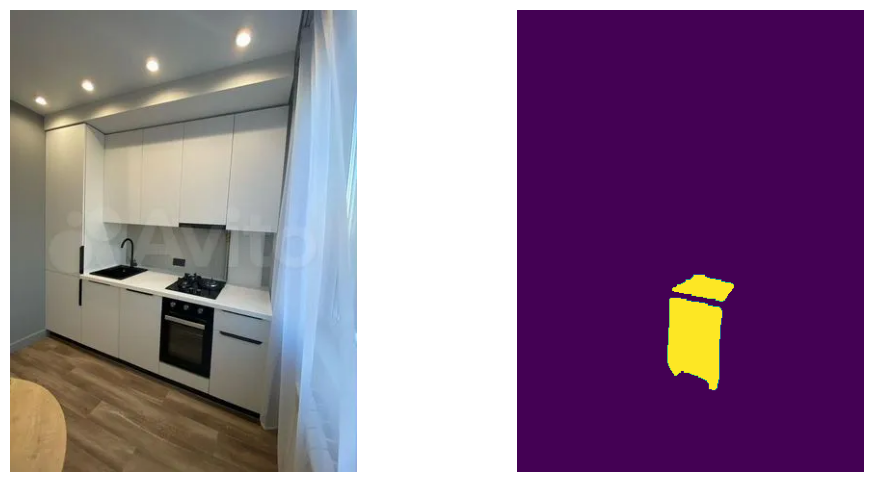

In [23]:
for i in range(37):
    test_image_path = sorted(all_test_images)[i]

    with torch.no_grad():
        img = cv2.imread(test_image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        transformed_data = test_transforms(image=img)
        transformed_img = transformed_data['image']
        model_input = torch.from_numpy(transformed_img).permute(2, 0, 1).unsqueeze(0)
        pred = model(model_input.to(device))
        mask = torch.sigmoid(pred).squeeze().cpu() > 0.5
        resized_mask = cv2.resize(
            mask.numpy().transpose((1, 2, 0)).astype(int),
            (img.shape[1], img.shape[0]),
            interpolation=cv2.INTER_NEAREST
        )
    plot_images_side_by_side(img, resized_mask.sum(2, keepdims=True))

In [24]:
submission_df = get_submission_df(all_test_images, test_transforms, model)
submission_df.to_csv(
    'solution.csv', 
    header=['image_id', 'rle', 'batch_number'], 
    index=False
)

In [29]:
submission_df

,image_id,rle,batch_number
0,1.1Yn_RLa5eWDJ8_tt2WP76Yjme2ZB5ft2yeh7Yk3xfWI....,916311 8 917271 8 918231 8 919191 10 920151 10...,0.0
1,1.21iZK7a5d7GvgrW0o2jea4CKdbcnivW57491syuec7M....,136788 1 137243 1 137696 3 138151 3 138604 7 1...,1.0
2,1.6BF4H7a5RPhOqMb1JATYBg-9Rv7GvsbuTrNG-sqqQPo....,;594781 23 595741 23 596686 43 597646 43 59859...,2.0
3,1.6OGyIra5RAiElcYF7mWfxL2ARg4Mg8YehI5GCgCXQAo....,85941 8 86896 15 87856 15 88816 15 89776 15 90...,3.0
4,1.6mu5eLa5RoKP0YSH4U_gQLPaRIQH2cSKz9xEgAvNQoA....,146744 1 147224 2 147704 4 148184 5 148663 7 1...,4.0
5,1.71jzCba5Q7HFoIG0oTqiUe2rQbdNqMG5ha1Bs0G8R7M....,32443 2 32921 4 33401 4 33880 5 34359 7 34839 ...,5.0
6,1.AcS737a5rS2Ndm8oteMW5a59rysFfi8lzXuvLwlqqS8....,;134669 6 135149 6 135628 10 136108 10 136586 ...,6.0
7,1.DqbsP7a5ok_aiCBC_F8Lq-2doElSniBZ2pOgTV6Kpk0....,345186 3 346144 5 347104 5 348064 5 349024 5 3...,7.0
8,1.EBLIl7a5vPv-ID725I8xab41vv12Nj7t_ju--XoiuPk....,266199 2;256971 3 257634 3 258276 26 258941 24...,8.0
9,1.Ft5t7ba5ujdbWjg6Te0AznxMuDHTTDghW0G4Nd9YvjU....,374984 2 375944 2 376896 13 377856 13 378814 1...,9.0
